# 1. Realiza un estudio detallado del dataset, cualitativo y cuantitativo
Primero vamos a leer el dataset e imprimirlo para ver los datos que tenemos

In [2]:
import pandas as pd
df = pd.read_csv("UPM_power_building_consumption.csv")

In [3]:
df

,campus,espacio,fecha_medicion,consumo,bloque
0,campus_montegancedo,Despacho_3610,2019-03-29 01:15:00,0.01100,3
1,campus_montegancedo,Despacho_3610,2019-03-29 01:30:00,0.02100,3
2,campus_montegancedo,Despacho_3610,2019-03-29 01:45:00,0.03800,3
3,campus_montegancedo,Despacho_3610,2019-03-29 02:00:00,0.87100,3
4,campus_montegancedo,Despacho_3610,2019-03-29 02:15:00,0.87300,3
...,...,...,...,...,...
8095519,campus_sur,Despacho_1343,2022-04-30 22:45:00,0.84375,1
8095520,campus_sur,Despacho_1343,2022-04-30 23:00:00,1.15625,1
8095521,campus_sur,Despacho_1343,2022-04-30 23:15:00,1.32813,1
8095522,campus_sur,Despacho_1343,2022-04-30 23:30:00,1.21875,1


In [4]:
# Resumen de las columnas
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8095524 entries, 0 to 8095523
Data columns (total 5 columns):
 #   Column          Dtype  
---  ------          -----  
 0   campus          object 
 1   espacio         object 
 2   fecha_medicion  object 
 3   consumo         float64
 4   bloque          int64  
dtypes: float64(1), int64(1), object(3)
memory usage: 308.8+ MB
None


El dataset aunque es extenso en ejemplos (8 millones) presenta muy pocas características (5): Dividimos en objetos y numéricos.
Por una parte, los objetos nos dictan de qué campus, habitación y tanto la fecha como la hora a la que fue hecha la medición. Luego tenemos numerales, que nos dictan la medición de gasto energético (float64) y el bloque del campus en el que se realizaron (int64).

In [6]:
# Descripción estadística general para datos numéricos
print(df.describe())

            consumo        bloque
count  8.095524e+06  8.095524e+06
mean   1.308048e+01  2.362764e+00
std    1.505012e+01  9.311941e-01
min   -2.279800e+01  1.000000e+00
25%    3.014650e+00  2.000000e+00
50%    8.500000e+00  3.000000e+00
75%    1.737500e+01  3.000000e+00
max    1.168750e+02  4.000000e+00


Aquí podemos ver algunas métricas relevantes de las características numéricas

In [8]:
# Resumen de datos cualitativos
print(df.describe(include=['object']))

            campus        espacio       fecha_medicion
count      8095524        8095524              8095524
unique           2             63               152206
top     campus_sur  Despacho_3835  2020-02-20 02:00:00
freq       4121268         276116                   64


Claramente, tenemos que convertir el campus y el espacio en categóricos por los pocos valores distintos que tienen (2 y 63 respectivamente), y la fecha_medición en datetime.

In [10]:
# Valores únicos en cada columna cualitativa
print(df['campus'].value_counts())
print(df['espacio'].value_counts())
print(df['bloque'].value_counts())


campus
campus_sur             4121268
campus_montegancedo    3974256
Name: count, dtype: int64
espacio
Despacho_3835    276116
Despacho_3911    148288
Despacho_3722    148203
Despacho_2421    148127
Despacho_2724    148050
                  ...  
Despacho_2111     45926
Despacho_3727     40875
Despacho_3610     40761
Despacho_2910     35567
Despacho_2439     33275
Name: count, Length: 63, dtype: int64
bloque
3    3657335
1    1956321
2    1863991
4     617877
Name: count, dtype: int64


La columna bloque, aunque sea numérica, tiene solo 4 valores distintos (solo hay 4 bloques)

Leyendo el enunciado de la práctica, no vamos a utilizar la columna espacio, por lo que es innecesaria, la eliminamos.

In [13]:
df.drop(["espacio"], axis = "columns", inplace = True)
df.columns

Index(['campus', 'fecha_medicion', 'consumo', 'bloque'], dtype='object')

### Tratamiento de datos faltantes

<Axes: >

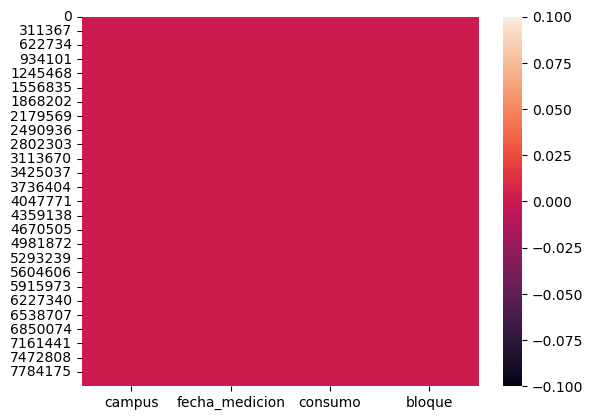

In [15]:
import seaborn as sns
sns.heatmap(df.isnull())

In [16]:
df.isnull().sum().sum()

0

No tenemos valores nulos

### Conversión de tipos

Convertimos la columna campus a categórica, y la fecha_medición a datetime.

In [20]:
df['campus'] = df['campus'].astype('category')
df['fecha_medicion'] = pd.to_datetime(df['fecha_medicion'])
df.dtypes

campus                  category
fecha_medicion    datetime64[ns]
consumo                  float64
bloque                     int64
dtype: object

Vamos a añadir al dataset 7 columnas que especifiquen el año, mes, día, hora, minuto, dia de la semana y hora:minuto por separado de la fecha_medicion, esto lo usaremos más adelante para visualizar los datos. Nos quedaremos solo con la fecha en fecha_medicion para facilitarnos las cosas más tarde.

In [22]:
df['año'] = df['fecha_medicion'].dt.year
df['mes'] = df['fecha_medicion'].dt.month
df['dia'] = df['fecha_medicion'].dt.day
df['hora'] = df['fecha_medicion'].dt.hour
df['minuto'] = df['fecha_medicion'].dt.minute
df['hora_minuto'] = df["hora"].astype(str).str.zfill(2) + ':' + df['minuto'].astype(str).str.zfill(2)
df['dia_semana'] = df['fecha_medicion'].dt.dayofweek
df['fecha_medicion']= df['fecha_medicion'].dt.date
df.head()

,campus,fecha_medicion,consumo,bloque,año,mes,dia,hora,minuto,hora_minuto,dia_semana
0,campus_montegancedo,2019-03-29,0.011,3,2019,3,29,1,15,01:15,4
1,campus_montegancedo,2019-03-29,0.021,3,2019,3,29,1,30,01:30,4
2,campus_montegancedo,2019-03-29,0.038,3,2019,3,29,1,45,01:45,4
3,campus_montegancedo,2019-03-29,0.871,3,2019,3,29,2,0,02:00,4
4,campus_montegancedo,2019-03-29,0.873,3,2019,3,29,2,15,02:15,4


Tenemos muestras que no son tomadas en intervalos de 15 minutos exactamente como por ejemplo 4:05, esto perjudica la visualización, dado que son unas pocas muestras, las vamos a eliminar

In [24]:
minutos_puntuales = df.minuto.isin([0, 15, 30, 45])
indices_minutos_raros = minutos_puntuales[minutos_puntuales == False].index.to_list()
df.drop(indices_minutos_raros, axis = "rows", inplace = True)

In [25]:
df

,campus,fecha_medicion,consumo,bloque,año,mes,dia,hora,minuto,hora_minuto,dia_semana
0,campus_montegancedo,2019-03-29,0.01100,3,2019,3,29,1,15,01:15,4
1,campus_montegancedo,2019-03-29,0.02100,3,2019,3,29,1,30,01:30,4
2,campus_montegancedo,2019-03-29,0.03800,3,2019,3,29,1,45,01:45,4
3,campus_montegancedo,2019-03-29,0.87100,3,2019,3,29,2,0,02:00,4
4,campus_montegancedo,2019-03-29,0.87300,3,2019,3,29,2,15,02:15,4
...,...,...,...,...,...,...,...,...,...,...,...
8095519,campus_sur,2022-04-30,0.84375,1,2022,4,30,22,45,22:45,5
8095520,campus_sur,2022-04-30,1.15625,1,2022,4,30,23,0,23:00,5
8095521,campus_sur,2022-04-30,1.32813,1,2022,4,30,23,15,23:15,5
8095522,campus_sur,2022-04-30,1.21875,1,2022,4,30,23,30,23:30,5


Hemos eliminado 303 filas

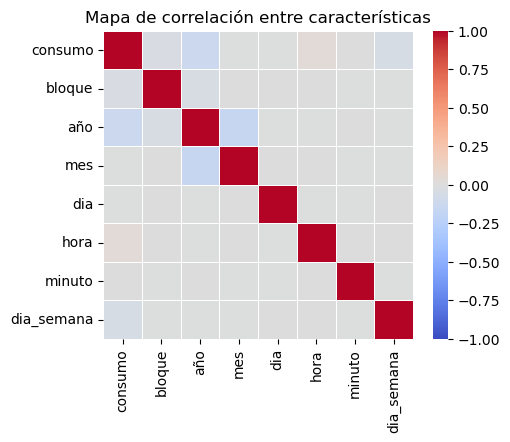

In [27]:
import matplotlib.pyplot as plt

correlation_matrix = df.select_dtypes(include = ["number"]).corr()
plt.figure(figsize=(5, 4))
sns.heatmap(correlation_matrix, cmap='coolwarm', vmin=-1, vmax=1, linewidths=0.5)
plt.title('Mapa de correlación entre características')
plt.show()

Claramente no hay variables altamente correlacionadas por la naturaleza de los datos

# 2. Realiza visualizaciones que nos permitan entender el consumo medio por bloque y campus en función de diferentes medidas de tiempo (días, semanas y meses). Describe los momentos temporales en los que se han producido eventos que han producido un importe efecto en la tendencia de consumo.

Vamos a separar los datos del campus montegancedo y campus sur

In [31]:
# Nos quedamos con los datos del campus_montegancedo
df_montegancedo = df[df['campus'] == 'campus_montegancedo']

# Nos quedamos con los datos del campus_montegancedo
df_sur = df[df['campus'] == 'campus_sur']

### Consumo medio diario de cada bloque por intervalos de 15 minutos

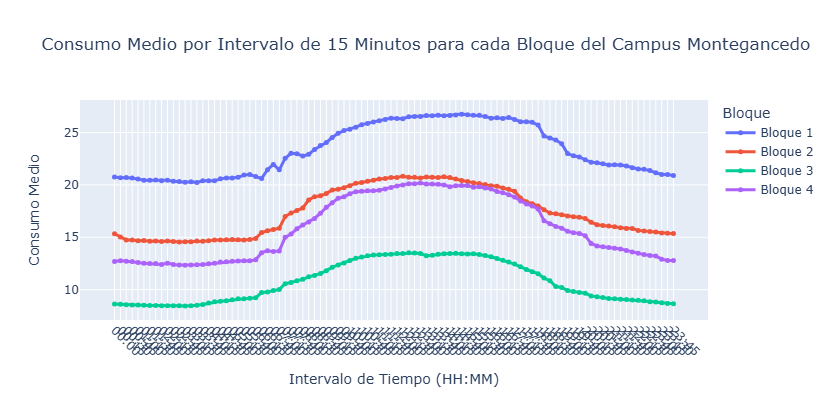

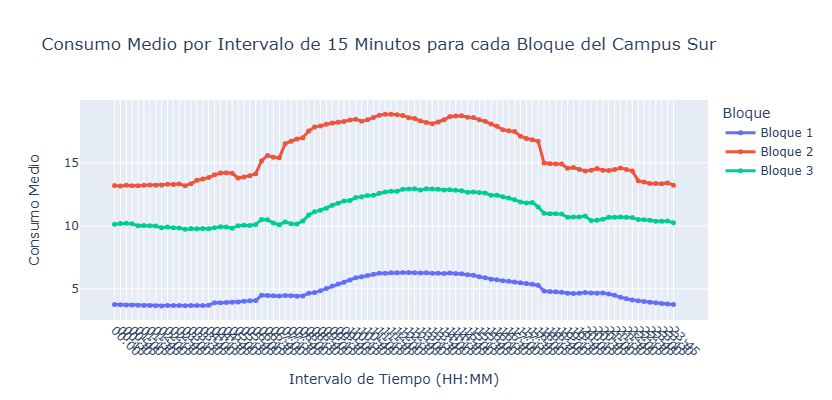

In [33]:
# !pip install plotly
import plotly.graph_objects as go
import pandas as pd

# Agrupamos por intervalos de 15 minutos y bloque para calcular el consumo medio
consumo_medio_por_intervalo_montegancedo = df_montegancedo.groupby(['hora_minuto', 'bloque'])['consumo'].mean().reset_index()

# Igual para los datos del campus sur
consumo_medio_por_intervalo_sur = df_sur.groupby(['hora_minuto', 'bloque'])['consumo'].mean().reset_index()

# Creamos gráfico con plotly para que sea interactivo y más fácil de visualizar
fig = go.Figure()

# Creamos una línea en el gráfico por cada bloque
for bloque in consumo_medio_por_intervalo_montegancedo['bloque'].unique():
    bloque_data = consumo_medio_por_intervalo_montegancedo[consumo_medio_por_intervalo_montegancedo['bloque'] == bloque]
    
    fig.add_trace(go.Scatter(
        x=bloque_data['hora_minuto'], 
        y=bloque_data['consumo'], 
        mode='lines+markers', 
        name=f'Bloque {bloque}', 
        line=dict(width=3),
        marker=dict(size=5)))

# Configuramos detalles de la visualización
fig.update_layout(
    title='Consumo Medio por Intervalo de 15 Minutos para cada Bloque del Campus Montegancedo',
    xaxis=dict(
        title='Intervalo de Tiempo (HH:MM)',
        tickmode='array',
        tickvals=consumo_medio_por_intervalo_montegancedo['hora_minuto'],
        tickangle=45
    ),
    yaxis=dict(title='Consumo Medio'),
    hovermode='closest',
    legend_title='Bloque',
    height=400 
)

# Mostramos gráfico interactivo
fig.show()

# Igual para los datos de montegancedo
fig = go.Figure()

# Creamos una línea en el gráfico por cada bloque
for bloque in consumo_medio_por_intervalo_sur['bloque'].unique():
    bloque_data = consumo_medio_por_intervalo_sur[consumo_medio_por_intervalo_sur['bloque'] == bloque]
    
    fig.add_trace(go.Scatter(
        x=bloque_data['hora_minuto'], 
        y=bloque_data['consumo'], 
        mode='lines+markers', 
        name=f'Bloque {bloque}', 
        line=dict(width=3),
        marker=dict(size=5)))

# Configuramos detalles de la visualización
fig.update_layout(
    title='Consumo Medio por Intervalo de 15 Minutos para cada Bloque del Campus Sur',
    xaxis=dict(
        title='Intervalo de Tiempo (HH:MM)',
        tickmode='array',
        tickvals=consumo_medio_por_intervalo_sur['hora_minuto'],
        tickangle=45
    ),
    yaxis=dict(title='Consumo Medio'),
    hovermode='closest',
    legend_title='Bloque',
    height=400 
)

# Mostramos gráfico interactivo
fig.show()

Como podemos ver, tanto en el Campus de Montegancedo como en el Sur, el consumo comienza a elevarse a partir de las 7-8 de la mañana lo cual tiene sentido ya que es cuando empieza la jornada laboral y los empleados, seguidos de los estudiantes comienzan a llegar a la universidad. El consumo se mantiene elevado durante las horas del día llegando a su pico al medio día y la hora de comer, a partir de las 17:00h comienza a descender el consumo ya que por las tardes parece haber menos gente en las universidades hasta disminuir a mínimos en horarios nocturnos. Hay una clara estacionalidad.  
Cabe destacar que en Montegancedo, para el consumo medio por intervalos de 15 minutos, el bloque 1 es el que más consume, seguido del 2, 4 y 3 y en el Campus Sur, en orden descendente de consumición vemos a los bloques 2, 3 y 1.

### Consumo medio de cada bloque por cada día de la semana

Para esta visualización, como ya no vamos a utilizar las horas, agrupamos por fecha y bloque, sumando el consumo diario por bloque

In [37]:
df_consumo_diario_montegancedo = df_montegancedo.groupby(['fecha_medicion','año', 'mes', 'dia', 
                                                              'dia_semana', 'bloque'])['consumo'].sum().reset_index()

df_consumo_diario_sur = df_sur.groupby(['fecha_medicion', 'año', 'mes', 'dia',
                                        'dia_semana', 'bloque'])['consumo'].sum().reset_index()
df_consumo_diario_sur.head()

,fecha_medicion,año,mes,dia,dia_semana,bloque,consumo
0,2018-01-01,2018,1,1,0,1,1512.60734
1,2018-01-01,2018,1,1,0,2,7471.24141
2,2018-01-01,2018,1,1,0,3,12936.12533
3,2018-01-02,2018,1,2,1,1,1858.38717
4,2018-01-02,2018,1,2,1,2,9040.92259


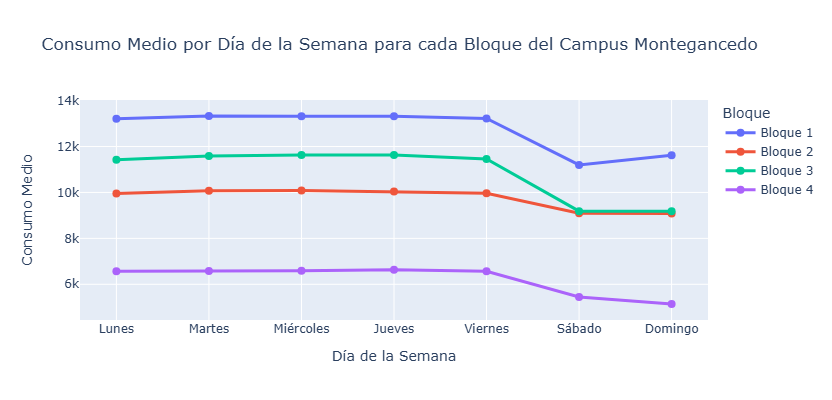

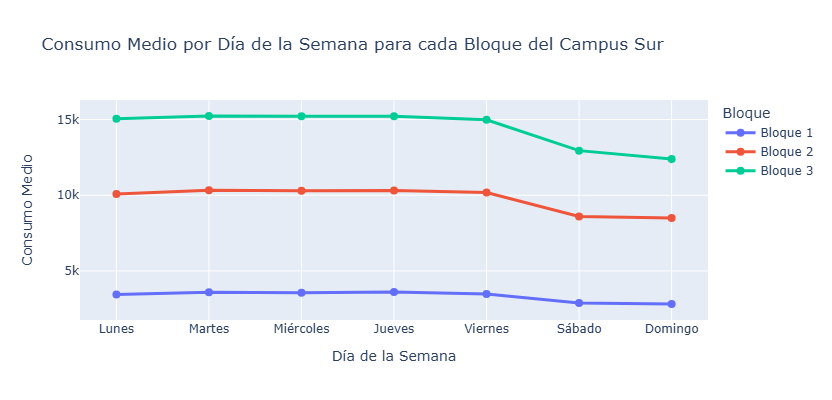

In [38]:
# Agrupamos por día de la semana y bloque para calcular el consumo medio
consumo_medio_por_dia_semana_montegancedo = df_consumo_diario_montegancedo.groupby(['dia_semana', 'bloque'])['consumo'].mean().reset_index()

# Igual para el Campus Sur
consumo_medio_por_dia_semana_sur = df_consumo_diario_sur.groupby(['dia_semana', 'bloque'])['consumo'].mean().reset_index()

# Mapeamos los números del día de la semana a nombres de días
dias_semana = ['Lunes', 'Martes', 'Miércoles', 'Jueves', 'Viernes', 'Sábado', 'Domingo']
consumo_medio_por_dia_semana_montegancedo['dia_nombre'] = consumo_medio_por_dia_semana_montegancedo['dia_semana'].apply(lambda x: dias_semana[x])
consumo_medio_por_dia_semana_sur['dia_nombre'] = consumo_medio_por_dia_semana_sur['dia_semana'].apply(lambda x: dias_semana[x])

# Creamos el gráfico interactivo
fig = go.Figure()

# Creamos una línea en el gráfico por cada bloque
for bloque in consumo_medio_por_dia_semana_montegancedo['bloque'].unique():
    bloque_data = consumo_medio_por_dia_semana_montegancedo[consumo_medio_por_dia_semana_montegancedo['bloque'] == bloque]
    
    fig.add_trace(go.Scatter(
        x=bloque_data['dia_nombre'], 
        y=bloque_data['consumo'], 
        mode='lines+markers', 
        name=f'Bloque {bloque}', 
        line=dict(width=3),
        marker=dict(size=8))) 

# Configuramos detalles de la visualización
fig.update_layout(
    title='Consumo Medio por Día de la Semana para cada Bloque del Campus Montegancedo',
    xaxis=dict(
        title='Día de la Semana',
        tickmode='array',
        tickvals=dias_semana,
        ticktext=dias_semana,
        categoryorder='array',
        categoryarray=dias_semana
    ),
    yaxis=dict(title='Consumo Medio'),
    hovermode='closest',
    legend_title='Bloque',
    height=400 
)

# Mostramos el gráfico interactivo
fig.show()

# Igual para el Campus Sur
fig = go.Figure()

# Creamos una línea en el gráfico por cada bloque
for bloque in consumo_medio_por_dia_semana_sur['bloque'].unique():
    bloque_data = consumo_medio_por_dia_semana_sur[consumo_medio_por_dia_semana_sur['bloque'] == bloque]
    
    fig.add_trace(go.Scatter(
        x=bloque_data['dia_nombre'], 
        y=bloque_data['consumo'], 
        mode='lines+markers', 
        name=f'Bloque {bloque}', 
        line=dict(width=3), 
        marker=dict(size=8)))  

# Configuramos detalles de la visualización
fig.update_layout(
    title='Consumo Medio por Día de la Semana para cada Bloque del Campus Sur',
    xaxis=dict(
        title='Día de la Semana',
        tickmode='array',
        tickvals=dias_semana,
        ticktext=dias_semana,
        categoryorder='array',
        categoryarray=dias_semana
    ),
    yaxis=dict(title='Consumo Medio'),
    hovermode='closest',
    legend_title='Bloque',
    height=400 
)

# Mostramos el gráfico interactivo
fig.show()

En este caso vemos que tanto el Campus Montegancedo como el Sur tienen una tendencia de consumo que era de esperar, durante los días laborales este es más elevado y bastante uniforme, en fin de semana desciende.  
En el Campus Montegancedo, en orden descendente de consumo medio por día de la semana vemos a los bloques 1, 3, 2 y 4, y en el Campus Sur a los bloques 3, 2 y 1, este orden se mantiene para el resto de visualizaciones del consumo medio por mes y año.

### Consumo medio mensual por cada bloque

Ahora vamos a quedarnos con el consumo total por mes y bloque para la visualización

In [42]:
df_consumo_mensual_montegancedo = df_montegancedo.groupby(['año', 'mes', 'bloque'])['consumo'].sum().reset_index()

df_consumo_mensual_sur = df_sur.groupby(['año', 'mes', 'bloque'])['consumo'].sum().reset_index()
df_consumo_mensual_sur.head()

,año,mes,bloque,consumo
0,2018,1,1,54080.41562
1,2018,1,2,312586.68961
2,2018,1,3,450304.87136
3,2018,2,1,46245.88914
4,2018,2,2,298776.65049


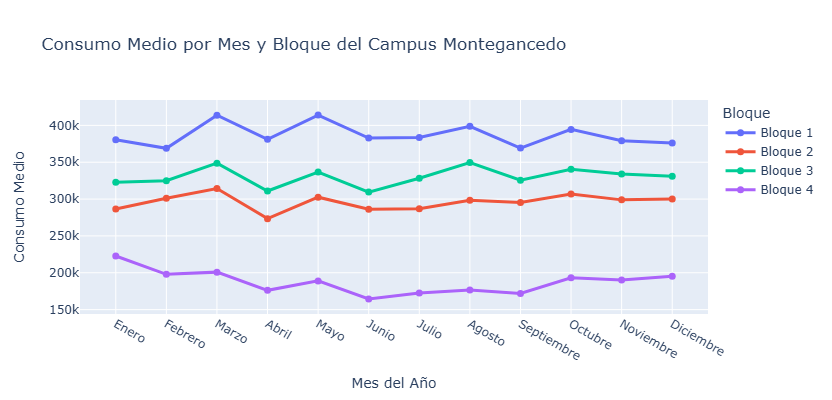

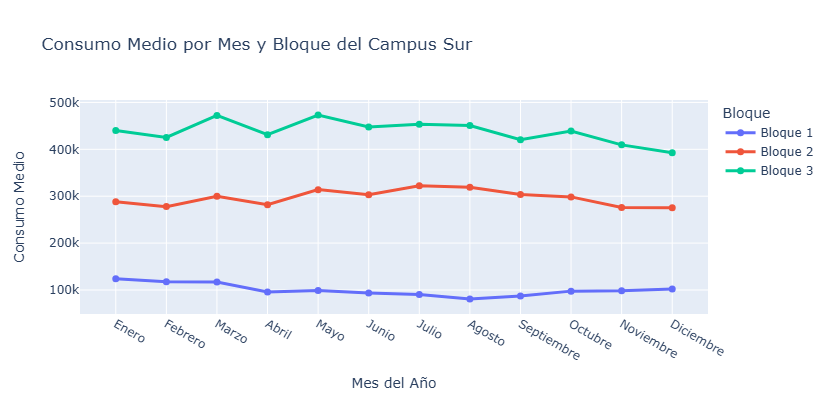

In [43]:
# Agrupamos por mes y bloque para calcular el consumo medio
consumo_medio_mensual_montegancedo = df_consumo_mensual_montegancedo.groupby(['mes', 'bloque'])['consumo'].mean().reset_index()

# Igual para el Campus Sur
consumo_medio_mensual_sur = df_consumo_mensual_sur.groupby(['mes', 'bloque'])['consumo'].mean().reset_index()

# Mapeamos los números de los meses a nombres de meses
meses = ['Enero', 'Febrero', 'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre', 'Octubre', 'Noviembre', 'Diciembre']
consumo_medio_mensual_montegancedo['mes_nombre'] = consumo_medio_mensual_montegancedo['mes'].apply(lambda x: meses[x-1])
consumo_medio_mensual_sur['mes_nombre'] = consumo_medio_mensual_sur['mes'].apply(lambda x: meses[x-1])

# Creamos el gráfico interactivo
fig = go.Figure()

# Creamos una línea en el gráfico por cada bloque
for bloque in consumo_medio_mensual_montegancedo['bloque'].unique():
    bloque_data = consumo_medio_mensual_montegancedo[consumo_medio_mensual_montegancedo['bloque'] == bloque]
    
    fig.add_trace(go.Scatter(
        x=bloque_data['mes_nombre'], 
        y=bloque_data['consumo'], 
        mode='lines+markers', 
        name=f'Bloque {bloque}', 
        line=dict(width=3), 
        marker=dict(size=7))) 

# Configuramos detalles de la visualización
fig.update_layout(
    title='Consumo Medio por Mes y Bloque del Campus Montegancedo',
    xaxis=dict(
        title='Mes del Año',
        tickmode='array',
        tickvals=meses,
        ticktext=meses,
        categoryorder='array',
        categoryarray=meses
    ),
    yaxis=dict(title='Consumo Medio'),
    hovermode='closest',
    legend_title='Bloque',
    height=400
)

# Mostramos el gráfico interactivo
fig.show()

# Lo mismo para el Campus Sur
fig = go.Figure()

# Creamos una línea en el gráfico por cada bloque
for bloque in consumo_medio_mensual_sur['bloque'].unique():
    bloque_data = consumo_medio_mensual_sur[consumo_medio_mensual_sur['bloque'] == bloque]
    
    fig.add_trace(go.Scatter(
        x=bloque_data['mes_nombre'], 
        y=bloque_data['consumo'], 
        mode='lines+markers', 
        name=f'Bloque {bloque}', 
        line=dict(width=3), 
        marker=dict(size=7))) 

# Configuramos detalles de la visualización
fig.update_layout(
    title='Consumo Medio por Mes y Bloque del Campus Sur',
    xaxis=dict(
        title='Mes del Año',
        tickmode='array',
        tickvals=meses,
        ticktext=meses,
        categoryorder='array',
        categoryarray=meses
    ),
    yaxis=dict(title='Consumo Medio'),
    hovermode='closest',
    legend_title='Bloque',
    height=400
)

# Mostramos el gráfico interactivo
fig.show()

En cuanto al consumo mensual, vemos una tendencia de consumo similar en ambos campus, con la diferencia de que en los bloques 1 y 3 del Campus Montegancedo y el 2 del Sur, hay más consumo en el periodo vacacional de verano, lo que nos sorprende, pero imaginamos que es porque se impartirá algún tipo de curso. Como era de esperar, en periodos vacacionales de Navidad y Semana Santa (Diciembre y Abril) desciende el consumo porque los alumnos no atienden a las aulas, igual que muchos empleados. Meses de Enero y Mayo tenemos un alto consumo por periodo de exámenes ya que los alumnos atienden más a las clases, igual que en Marzo, ya que antes de Semana Santa suele haber parciales. Por lo que hay una tendencia estacional.

### Consumo anual por bloque

Para esta visualización, sumamos el consumo para cada año por bloque

In [47]:
df_consumo_anual_montegancedo = df_montegancedo.groupby(['año', 'bloque'])['consumo'].sum().reset_index()

df_consumo_anual_sur = df_sur.groupby(['año', 'bloque'])['consumo'].sum().reset_index()
df_consumo_anual_sur.head()

,año,bloque,consumo
0,2018,1,6.412224e+05
1,2018,2,4.128920e+06
2,2018,3,5.676291e+06
3,2019,1,1.358758e+06
4,2019,2,4.616592e+06


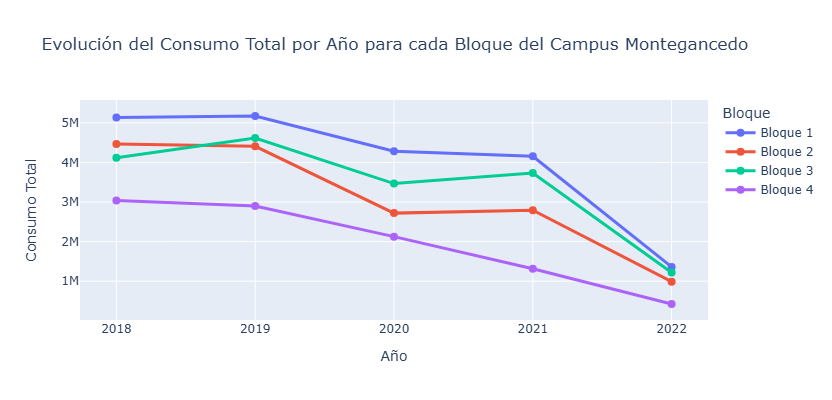

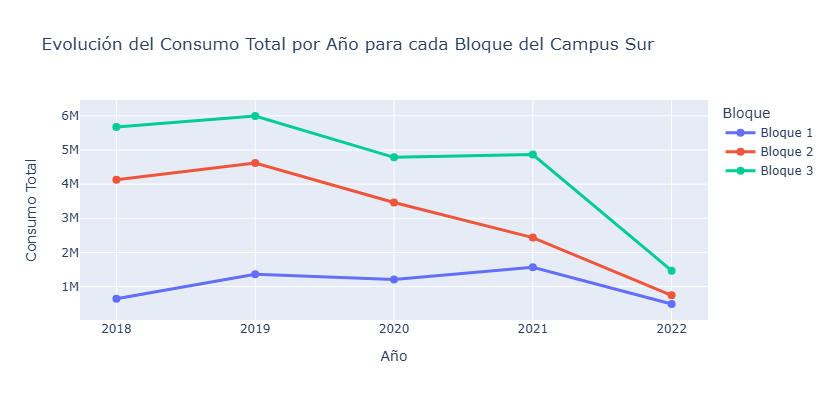

In [48]:
import plotly.graph_objects as go
import pandas as pd

# Agrupamos por año y bloque para calcular el consumo total por mes
consumo_anual_montegancedo = df_consumo_anual_montegancedo.groupby(['año', 'bloque'])['consumo'].mean().reset_index()

# Lo mismo para el campus sur
consumo_anual_sur = df_consumo_anual_sur.groupby(['año', 'bloque'])['consumo'].mean().reset_index()

# Creamos el gráfico interactivo del Campus Montegancedo
fig = go.Figure()

# Creamos una línea en el gráfico por cada bloque
for bloque in consumo_anual_montegancedo['bloque'].unique():
    bloque_data = consumo_anual_montegancedo[consumo_anual_montegancedo['bloque'] == bloque]
    
    fig.add_trace(go.Scatter(
        x=bloque_data['año'], 
        y=bloque_data['consumo'], 
        mode='lines+markers', 
        name=f'Bloque {bloque}', 
        line=dict(width=3),
        marker=dict(size=8))) 

# Configuramos detalles de visualización
fig.update_layout(
    title='Evolución del Consumo Total por Año para cada Bloque del Campus Montegancedo',
    xaxis=dict(title='Año'),
    yaxis=dict(title='Consumo Total'),
    hovermode='closest',
    legend_title='Bloque',
    height=400
)

# Mostramos el gráfico interactivo del Campus Montegancedo
fig.show()

# Creamos el gráfico interactivo del Campus Sur
fig = go.Figure()

# Creamos una línea en el gráfico por cada bloque
for bloque in consumo_anual_sur['bloque'].unique():
    bloque_data = consumo_anual_sur[consumo_anual_sur['bloque'] == bloque]
    
    fig.add_trace(go.Scatter(
        x=bloque_data['año'], 
        y=bloque_data['consumo'], 
        mode='lines+markers', 
        name=f'Bloque {bloque}', 
        line=dict(width=3),  
        marker=dict(size=8)))  

# Configuramos detalles de visualización
fig.update_layout(
    title='Evolución del Consumo Total por Año para cada Bloque del Campus Sur',
    xaxis=dict(title='Año'),
    yaxis=dict(title='Consumo Total'),
    hovermode='closest',
    legend_title='Bloque',
    height=400
)

# Mostramos el gráfico interactivo del Campus Montegancedo
fig.show()

Podemos ver que, en ambos Campus hubo una bajada del consumo en 2020, debido al Covid-19, ya que tanto empleados como alumnos no tenían que acudir a la universidad. En 2021 seguíamos con la recuperación de la pandemia con clases online, por eso también el bajo consumo. Vemos un bajo consumo en ambos campus en 2022, esto es porque tenemos mucha más información de los años 2018-2021, puesto que del 2022 solo tenemos datos para los primeros 4 meses.

# 3. Desarrolla modelos de predicción de consumo en los 6 meses posteriores a la fecha de último dato recogido en el dataset. Haz un análisis detallado de los resultados obtenidos, y describe los problemas (si los hay) para conseguir cifras de acierto más altas.


Para esta tarea vamos a estudiar un bloque del campus sur

In [52]:
df_sur_agrupado = df_consumo_diario_sur.groupby(['fecha_medicion','año','mes','dia','dia_semana','bloque'])['consumo'].sum().reset_index()
# Determinar la fecha límite de los últimos 6 meses
ultima_fecha_sur = pd.Timestamp(df_sur_agrupado['fecha_medicion'].max())
fecha_limite= (ultima_fecha_sur - pd.DateOffset(months=6)).date()
fechas_T_missing = df_sur_agrupado[df_sur_agrupado["fecha_medicion"]>=fecha_limite].fecha_medicion

In [53]:
df = df_sur_agrupado[df_sur_agrupado.bloque == 1]
df_antes = df[df["fecha_medicion"]<fecha_limite]
df_despues = df[df["fecha_medicion"]>=fecha_limite]
fechas_T_missing = df[df["fecha_medicion"]>=fecha_limite].fecha_medicion

In [54]:
df

,fecha_medicion,año,mes,dia,dia_semana,bloque,consumo
0,2018-01-01,2018,1,1,0,1,1512.60734
3,2018-01-02,2018,1,2,1,1,1858.38717
6,2018-01-03,2018,1,3,2,1,1870.58753
9,2018-01-04,2018,1,4,3,1,1985.61600
12,2018-01-05,2018,1,5,4,1,2035.96913
...,...,...,...,...,...,...,...
4715,2022-04-26,2022,4,26,1,1,4207.41258
4718,2022-04-27,2022,4,27,2,1,4127.96528
4721,2022-04-28,2022,4,28,3,1,4266.89561
4724,2022-04-29,2022,4,29,4,1,4029.30311


Usaremos varios métodos para predecir, entre los que se encuentran regresión linear, polinómica, Ridge, Lasso, ElasticNet y descenso del gradiente.

Para comparaciones mas adelante, crearemos un diccionario con el mae e iremos guardando ahí los resultados.

In [56]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_absolute_error

# Preparación de los datos
X_train = pd.DataFrame(df_antes["fecha_medicion"].map(lambda x: x.toordinal()))
X_test = pd.DataFrame(df_despues["fecha_medicion"].map(lambda x: x.toordinal()))
y_train = df_antes['consumo']
y_test = df_despues['consumo']

# Modelos de regresión
modelos = {
    'Lineal': LinearRegression(),
    'Polinómica': PolynomialFeatures(degree=5),
    'ElasticNet': ElasticNet(alpha=0.1, l1_ratio=0.5),
    'RandomForest': RandomForestRegressor(n_estimators=100, random_state=42),
    'MLP': MLPRegressor(hidden_layer_sizes=(20,), max_iter=1000, random_state=42)
}

# Entrenamiento y evaluación
resultados = {}
mae_dict = {}
# Regresión lineal
modelo = modelos['Lineal']
modelo.fit(X_train, y_train)
y_pred = modelo.predict(X_test)
resultados['Lineal'] = mean_absolute_error(y_test, y_pred)

# Regresión polinómica
poly = modelos['Polinómica']
X_train_poly = poly.fit_transform(X_train)
X_test_poly = poly.transform(X_test)
modelo_poly = LinearRegression().fit(X_train_poly, y_train)
y_pred_poly = modelo_poly.predict(X_test_poly)
resultados['Polinómica'] = mean_absolute_error(y_test, y_pred_poly)

# ElasticNet
modelo = modelos['ElasticNet']
modelo.fit(X_train, y_train)
y_pred_elnet = modelo.predict(X_test)
resultados['ElasticNet'] = mean_absolute_error(y_test, y_pred_elnet)

# RandomForest
modelo = modelos['RandomForest']
modelo.fit(X_train, y_train)
y_pred_rf = modelo.predict(X_test)
resultados['RandomForest'] = mean_absolute_error(y_test, y_pred_rf)

# MLP
modelo = modelos['MLP']
modelo.fit(X_train, y_train)
y_pred_mlp = modelo.predict(X_test)
resultados['MLP'] = mean_absolute_error(y_test, y_pred_mlp)

# Mostrar resultados
for nombre, mae in resultados.items():
    print(f"{nombre}: MAE={mae}")

Lineal: MAE=525.1415837711684
Polinómica: MAE=461.52236792510354
ElasticNet: MAE=525.1411733878573
RandomForest: MAE=411.9570688644448
MLP: MAE=986.9832633070981


In [57]:
resultados_df = pd.DataFrame({
    'Lineal': modelos['Lineal'].predict(X_test),
    'Polinómica': modelo_poly.predict(X_test_poly),
    'MLP': modelos['MLP'].predict(X_test),
    'RandomForest': modelos['RandomForest'].predict(X_test),
    'ElasticNet': modelos['ElasticNet'].predict(X_test)
})

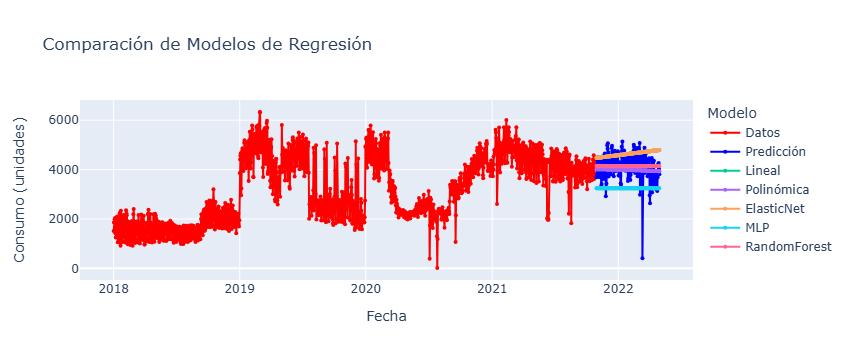

In [58]:
import plotly.graph_objects as go

fig = go.Figure()

# Datos Reales
fig.add_trace(go.Scatter(
    x=df_antes["fecha_medicion"], 
    y=df_antes["consumo"], 
    mode='lines+markers',
    name='Datos',
    line=dict(width=2, color='red'), 
    marker=dict(size=4)
))


fig.add_trace(go.Scatter(
    x=df_despues["fecha_medicion"], 
    y=df_despues["consumo"], 
    mode='lines+markers',
    name='Predicción',
    line=dict(width=2, color='blue'), 
    marker=dict(size=4)
))

# Predicciones de los Modelos
for modelo in ['Lineal', 'Polinómica', 'ElasticNet', 'MLP', 'RandomForest']:
    fig.add_trace(go.Scatter(
        x=df_despues['fecha_medicion'], 
        y=resultados_df[modelo], 
        mode='lines+markers',
        name=modelo,
        line=dict(width=2), 
        marker=dict(size=4)
    ))

# Configuración del Diseño
fig.update_layout(
    title='Comparación de Modelos de Regresión',
    xaxis_title='Fecha',
    yaxis_title='Consumo (unidades)',
    hovermode='closest',
    legend_title="Modelo",
    font=dict(size=12)
)

# Mostrar Gráfico
fig.show()

Como podemos observar, los resultados son algo penosos, pues los datos poseen una naturaleza muy compleja, tomando en cuenta variables como días festivos, pandemias, huelgas, el día de la semana, el mes (pues afrontemoslo, muchos alumnos dejan de ir a clase según avanzan los cuatrimestres)... Para datos de esta naturaleza, lo mejor sería utilizar algoritmos más apropiados para este problema, como series temporales que utilicen los datos, tendencias y un largo etcétera

# 4. Haz un análisis individualizado por cada uno de los bloques. Extrae la serie temporal y agrupa los datos por día. Aplica todas las técnicas de análisis de series temporales vistas en clase y realiza una comparativa y análisis exhaustivo de cada bloque.


In [61]:
# Agrupar los datos de 'df_montegancedo' por 'bloque' y 'fecha_medicion', y sumar el 'consumo'
grupos_montegancedo = df_montegancedo.groupby(['bloque', 'fecha_medicion'])['consumo'].sum().reset_index()
grupos_montegancedo_antes_6_meses = grupos_montegancedo[grupos_montegancedo['fecha_medicion'] < fecha_limite]

# Crear una lista de dataframes por cada grupo de 'bloque'
dataframes_por_grupo_montegancedo = [data for _, data in grupos_montegancedo.groupby('bloque')]
dataframes_por_grupo_montegancedo_antes_6_meses = [data for _, data in grupos_montegancedo_antes_6_meses.groupby('bloque')]

# Agrupar los datos de 'df_sur' por 'bloque' y 'fecha_medicion', y sumar el 'consumo'
grupos_sur = df_sur.groupby(['bloque', 'fecha_medicion'])['consumo'].sum().reset_index()
grupos_sur_antes_6_meses = grupos_sur[grupos_sur['fecha_medicion'] < fecha_limite]

# Crear una lista de dataframes por cada grupo de 'bloque'
dataframes_por_grupo_sur = [data for _, data in grupos_sur.groupby('bloque')]
dataframes_por_grupo_sur_antes_6_meses = [data for _, data in grupos_sur_antes_6_meses.groupby('bloque')]

T_missing = range(1336, 1576)

Separamos los datos en Xs y Xs_full (entrenamiento y datos)

In [62]:
Xs_montegancedo = [df.consumo for df in dataframes_por_grupo_montegancedo_antes_6_meses]
Xs_full_montegancedo = [df.consumo for df in dataframes_por_grupo_montegancedo]

Xs_sur = [df.consumo for df in dataframes_por_grupo_sur_antes_6_meses]
Xs_full_sur = [df.consumo for df in dataframes_por_grupo_sur]

In [63]:
from plotly.subplots import make_subplots
def subplots(Xs, Xs_full, dataframes_por_grupo_antes_6_meses, dataframes_por_grupo):
    num_subplots = len(Xs)
    
    # Crear la figura con más espacio entre los subgráficos
    fig = make_subplots(
        rows=num_subplots, cols=1, shared_xaxes=True,
        subplot_titles=["Bloque"+str(i+1) for i in range(num_subplots)],
        vertical_spacing=0.00005  # Aumenta este valor para más espacio entre subgráficos
    )
    
    # Iterar sobre los grupos de datos y añadir las trazas
    for i in range(num_subplots):
        # Añadir la línea de consumo para el grupo en Xs_full_montegancedo
        fig.add_trace(go.Scatter(
            x=dataframes_por_grupo[i]['fecha_medicion'], 
            y=Xs_full[i], 
            mode='lines+markers',  # Modo línea
            name='Consumo',
            line=dict(width=2, color='red'), 
            marker=dict(size=4)),
            row=i+1, col=1)
    
        # Añadir la línea de los 6 últimos meses para el grupo en Xs_montegancedo
        fig.add_trace(go.Scatter(
            x=dataframes_por_grupo_antes_6_meses[i]['fecha_medicion'], 
            y=Xs[i], 
            mode='lines+markers',  # Modo línea
            name='Datos',
            line=dict(width=2, color='blue'), 
            marker=dict(size=4)),
            row=i+1, col=1)
    
    # Configuración del diseño
    fig.update_layout(
        title='Consumo Diario Agrupado',
        xaxis_title='Fecha',
        yaxis_title='Consumo (unidades)',
        hovermode='closest',
        legend_title="Tipo",
        font=dict(size=12),
        showlegend=True,
        margin=dict(t=40, b=40, l=50, r=50)  # Márgenes para mejorar la visibilidad
    )
    
    # Mostrar el gráfico
    fig.show()

In [64]:
from sklearn.metrics import mean_absolute_error
def calcular_MAE(Xs_full, X_hat_series):
    maes = []
    for i, X in enumerate(X_hat_series):
        if len(X)>=1000:  
            mae = mean_absolute_error(Xs_full[i][T_missing], X[T_missing])
        else:
            mae = mean_absolute_error(Xs_full[i][T_missing], X)
        print(f"El error absoluto medio en la predicción del bloque: {i} es de: {mae}")
        maes.append(mae)
    return maes

def media_diccionario(maes1,maes2,nombre,diccionario=mae_dict):
    media = np.mean(np.hstack((maes1,maes2)))
    diccionario[nombre] = media
    print(f"Media de maes: {media}")



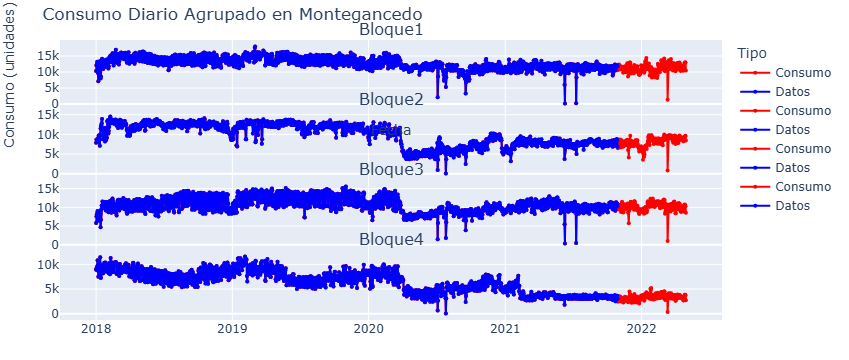

In [65]:
subplots(Xs_montegancedo, Xs_full_montegancedo, dataframes_por_grupo_montegancedo_antes_6_meses, dataframes_por_grupo_montegancedo)

Análisis

- El bloque uno es el único que no presenta una gran bajada con la aparición de la pandemia, sus datos parecen no variar mucho en general, con picos negativos repentinos probablemente por días festivos

- Los bloques del 2 al 3 presentan características similares; con la aparición de la pandemia los datos pasan a tomar valores más negativos, los cuales solamente suben en el bloque 3 cuando esta desaparece. En cuanto a magnitudes, al igual que el bloque 1; presentan picos negativos en dias festivos

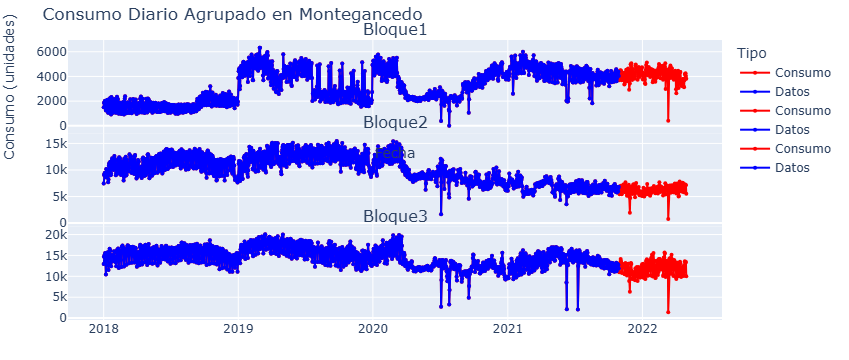

In [67]:
subplots(Xs_sur, Xs_full_sur, dataframes_por_grupo_sur_antes_6_meses, dataframes_por_grupo_sur)

Análisis

- El bloque 1 presenta datos muy erráticos pre-pandemia, y una recuperación y estabilidad después de la finalización de esta.
- El bloque 2 presenta una bajada con la aparición del covid que no se recupera al menos hasta el momento de toma de estos datos
- El bloque 3 sigue los pasos del bloque 2

#### Con todo esto en mente, pasemos a el planteamiento de las distintas técnicas de series temporales

In [70]:
Xs_montegancedo = [X.to_numpy() for X in Xs_montegancedo]
Xs_sur = [X.to_numpy() for X in Xs_sur]
Xs_full_montegancedo = [X.to_numpy() for X in Xs_full_montegancedo]
Xs_full_sur = [X.to_numpy() for X in Xs_full_sur]


Xs_montegancedo[0]

array([10320.219  , 12066.8425 , 12398.6735 , ..., 11989.77115,
       12116.40307, 11740.2432 ])

In [71]:
fechas_T_missing

4190    2021-10-30
4193    2021-10-31
4196    2021-11-01
4199    2021-11-02
4202    2021-11-03
           ...    
4715    2022-04-26
4718    2022-04-27
4721    2022-04-28
4724    2022-04-29
4727    2022-04-30
Name: fecha_medicion, Length: 180, dtype: object

### Naïve-forecasting

In [73]:
def subplots_X_hat_naive(Xs, Xs_full, dataframes_por_grupo_antes_6_meses, dataframes_por_grupo, X_hat_series):
    num_subplots = len(Xs)
    
    # Crear la figura con más espacio entre los subgráficos
    fig = make_subplots(
        rows=num_subplots, cols=1, shared_xaxes=True,
        subplot_titles=["Bloque"+str(i+1) for i in range(num_subplots)],
        vertical_spacing=0.00005  # Aumenta este valor para más espacio entre subgráficos
    )
    
    # Iterar sobre los grupos de datos y añadir las trazas
    for i in range(num_subplots):
        # Añadir la línea de consumo para el grupo en Xs_full_montegancedo
        fig.add_trace(go.Scatter(
            x=dataframes_por_grupo[i]['fecha_medicion'], 
            y=Xs_full[i], 
            mode='lines+markers',  # Modo línea
            name='Consumo',
            line=dict(width=2, color='red'), 
            marker=dict(size=4)),
            row=i+1, col=1)
    
        # Añadir la línea de los 6 últimos meses para el grupo en Xs_montegancedo
        fig.add_trace(go.Scatter(
            x=dataframes_por_grupo_antes_6_meses[i]['fecha_medicion'], 
            y=Xs[i], 
            mode='lines+markers',  # Modo línea
            name='Datos',
            line=dict(width=2, color='blue'), 
            marker=dict(size=4)),
            row=i+1, col=1)

        fig.add_trace(go.Scatter(
            x=fechas_T_missing, 
            y=X_hat_series[i], 
            mode='lines+markers',  # Modo línea
            name='Predicciones',
            line=dict(width=2, color='orange'), 
            marker=dict(size=4)),
            row=i+1, col=1)
    
    # Configuración del diseño
    fig.update_layout(
        title='Consumo Diario Agrupado en Montegancedo',
        xaxis_title='Fecha',
        yaxis_title='Consumo (unidades)',
        hovermode='closest',
        legend_title="Tipo",
        font=dict(size=12),
        showlegend=True,
        margin=dict(t=40, b=40, l=50, r=50)  # Márgenes para mejorar la visibilidad
    )
    
    # Mostrar el gráfico
    fig.show()

In [74]:
def subplots_X_hat(Xs, Xs_full, dataframes_por_grupo_antes_6_meses, dataframes_por_grupo, X_hat_series):
    num_subplots = len(Xs)
    
    # Crear la figura con más espacio entre los subgráficos
    fig = make_subplots(
        rows=num_subplots, cols=1, shared_xaxes=True,
        subplot_titles=["Bloque"+str(i+1) for i in range(num_subplots)],
        vertical_spacing=0.00005  # Aumenta este valor para más espacio entre subgráficos
    )
    
    # Iterar sobre los grupos de datos y añadir las trazas
    for i in range(num_subplots):
        # Añadir la línea de consumo para el grupo en Xs_full_montegancedo
        fig.add_trace(go.Scatter(
            x=dataframes_por_grupo[i]['fecha_medicion'], 
            y=Xs_full[i], 
            mode='lines+markers',  # Modo línea
            name='Consumo',
            line=dict(width=2, color='red'), 
            marker=dict(size=4)),
            row=i+1, col=1)
    
        # Añadir la línea de los 6 últimos meses para el grupo en Xs_montegancedo
        fig.add_trace(go.Scatter(
            x=dataframes_por_grupo_antes_6_meses[i]['fecha_medicion'], 
            y=Xs[i], 
            mode='lines+markers',  # Modo línea
            name='Datos',
            line=dict(width=2, color='blue'), 
            marker=dict(size=4)),
            row=i+1, col=1)

        fig.add_trace(go.Scatter(
            x=fechas_T_missing, 
            y=X_hat_series[i][T_missing], 
            mode='lines+markers',  # Modo línea
            name='Predicciones',
            line=dict(width=2, color='orange'), 
            marker=dict(size=4)),
            row=i+1, col=1)
    
    # Configuración del diseño
    fig.update_layout(
        title='Consumo Diario Agrupado en Montegancedo',
        xaxis_title='Fecha',
        yaxis_title='Consumo (unidades)',
        hovermode='closest',
        legend_title="Tipo",
        font=dict(size=12),
        showlegend=True,
        margin=dict(t=40, b=40, l=50, r=50)  # Márgenes para mejorar la visibilidad
    )
    
    # Mostrar el gráfico
    fig.show()

In [75]:
import numpy as np

def X_hat(X, t):
    return X[-1]


# Aplicamos X_hat a cada grupo de datos en 'dataframes_por_grupo_montegancedo' y 'dataframes_por_grupo_sur'
X_hat_series_montegancedo_naive = [
    np.array([X_hat(df_grupo, t) for t in T_missing]) 
    for df_grupo in Xs_montegancedo
]

X_hat_series_sur_naive = [
    np.array([X_hat(df_grupo, t) for t in T_missing]) 
    for df_grupo in Xs_sur
]

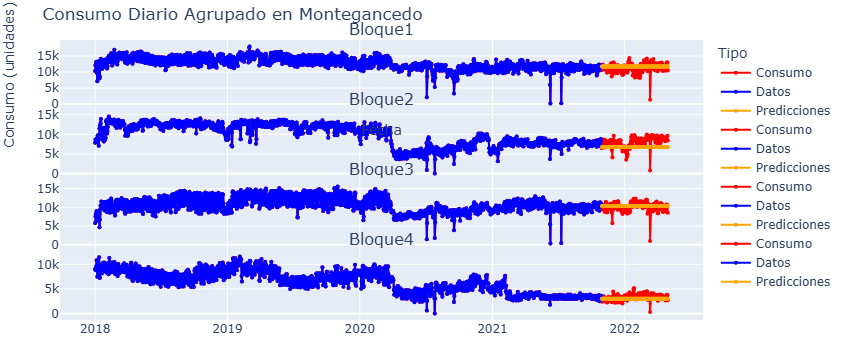

In [76]:
subplots_X_hat_naive(Xs_montegancedo, Xs_full_montegancedo, dataframes_por_grupo_montegancedo_antes_6_meses, dataframes_por_grupo_montegancedo, X_hat_series_montegancedo_naive)

In [77]:
mae1 = calcular_MAE(Xs_full_montegancedo, X_hat_series_montegancedo_naive)

El error absoluto medio en la predicción del bloque: 0 es de: 994.2054220416668
El error absoluto medio en la predicción del bloque: 1 es de: 1461.0539354583332
El error absoluto medio en la predicción del bloque: 2 es de: 811.8919425833333
El error absoluto medio en la predicción del bloque: 3 es de: 523.6942942083333


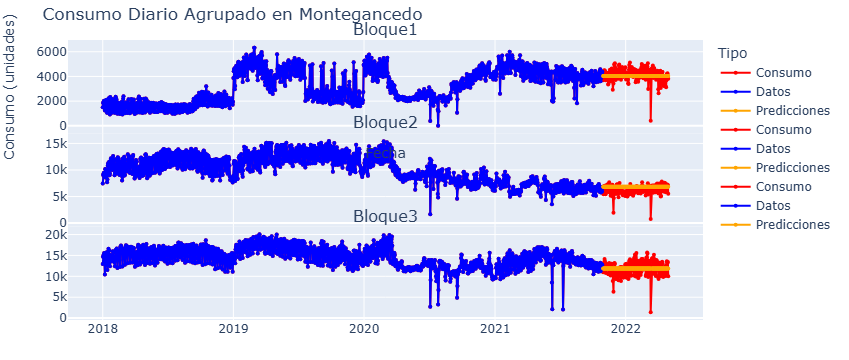

In [78]:
subplots_X_hat_naive(Xs_sur, Xs_full_sur, dataframes_por_grupo_sur_antes_6_meses, dataframes_por_grupo_sur, X_hat_series_sur_naive)

In [79]:
mae2= calcular_MAE(Xs_full_sur, X_hat_series_sur_naive)

El error absoluto medio en la predicción del bloque: 0 es de: 400.16284558333336
El error absoluto medio en la predicción del bloque: 1 es de: 704.1687441249999
El error absoluto medio en la predicción del bloque: 2 es de: 1448.1709873333336


In [80]:
media_diccionario(mae1,mae2,"Naive")

Media de maes: 906.192595904762


### Simple regression

In [82]:
# Definir la ventana (W)
from sklearn.utils import shuffle
from sklearn import tree

W = 20

# Preparar los datos de entrenamiento
def prepare_data(X, W):
    N = X.shape[0]
    Xtrain = np.array([[X[i + h] for h in range(W)] for i in range(N - W - 1)])
    Ytrain = np.array([X[i] for i in range(W, N - 1)])
    return shuffle(Xtrain, Ytrain)

# Función de predicción
def X_hat(X, t, W, reg):
    # Predecir el valor para t usando el modelo de regresión
    X_input = np.array([X[t - W + h] for h in range(W)]).reshape(1, -1)
    prediction = reg.predict(X_input)[0]  # Retorna el valor de la predicción
    return prediction

# Entrenamiento y predicción para Montegancedo
def train_and_predict_montegancedo(Xs_montegancedo, T_missing, W):
    X_hat_series_montegancedo_simple_final = []

    for X in Xs_montegancedo:  # Iterar sobre las listas de series para Montegancedo
        N = X.shape[0]
        
        # Preparar los datos para el entrenamiento
        Xtrain, Ytrain = prepare_data(X, W)
        
        # Entrenamiento del modelo de regresión
        reg_montegancedo = tree.DecisionTreeRegressor()  # Usando un modelo de regresión de árbol de decisión
        reg_montegancedo.fit(Xtrain, Ytrain)
        
        # Realizar predicciones para las fechas faltantes
        predictions = []
        X_extended = X.copy()  # Crear una copia para extenderla

        for t in range(len(T_missing)):
            pred = X_hat(X_extended, X_extended.shape[0], W, reg_montegancedo)
            predictions.append(pred)
            X_extended = np.hstack((X_extended, pred))  # Agregar la predicción a la copia

        # Concatenar la serie original con las predicciones
        X_hat_series_montegancedo_simple_final.append(X_extended)

    return X_hat_series_montegancedo_simple_final


# Entrenamiento y predicción para Sur
def train_and_predict_sur(Xs_sur, T_missing, W):
    X_hat_series_sur_simple_final = []

    for X in Xs_sur:  # Iterar sobre las listas de series para Sur
        N = X.shape[0]
        
        # Preparar los datos para el entrenamiento
        Xtrain, Ytrain = prepare_data(X, W)
        
        # Entrenamiento del modelo para Sur
        reg_sur = tree.DecisionTreeRegressor()  # Usando un modelo de regresión de árbol de decisión
        reg_sur.fit(Xtrain, Ytrain)
        
        # Realizar predicciones
        predictions = []
        X_extended = X.copy()
        for t in range(len(T_missing)):
            pred = X_hat(X_extended, X_extended.shape[0], W, reg_sur)
            predictions.append(pred)
            X_extended = np.append(X_extended, pred)  # Agregar la predicción a la copia

        X_hat_series_sur_simple_final.append(np.concatenate([X, predictions]))
    return X_hat_series_sur_simple_final


In [83]:
X_hat_series_montegancedo_simple = train_and_predict_montegancedo(Xs_montegancedo, T_missing, W)
X_hat_series_sur_simple = train_and_predict_sur(Xs_sur, T_missing, W)

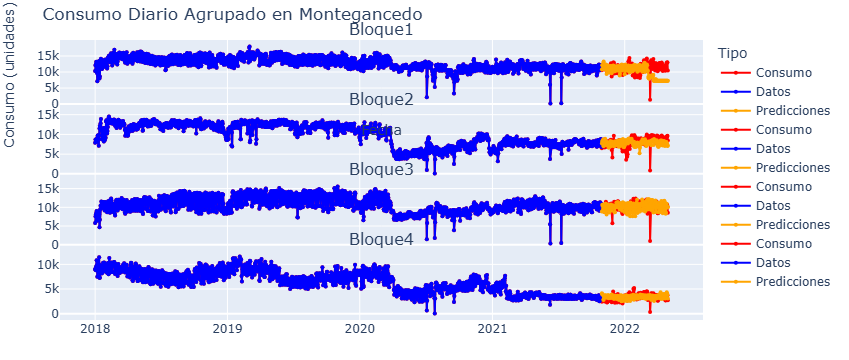

In [84]:
subplots_X_hat(Xs_montegancedo, Xs_full_montegancedo, dataframes_por_grupo_montegancedo_antes_6_meses, dataframes_por_grupo_montegancedo, X_hat_series_montegancedo_simple)

In [85]:
mae1 = calcular_MAE(Xs_full_montegancedo, X_hat_series_montegancedo_simple)

El error absoluto medio en la predicción del bloque: 0 es de: 2213.9747635833332
El error absoluto medio en la predicción del bloque: 1 es de: 1021.6792297916668
El error absoluto medio en la predicción del bloque: 2 es de: 960.9955122083334
El error absoluto medio en la predicción del bloque: 3 es de: 406.010023375


In [86]:
len(X_hat_series_montegancedo_simple[1])

1636

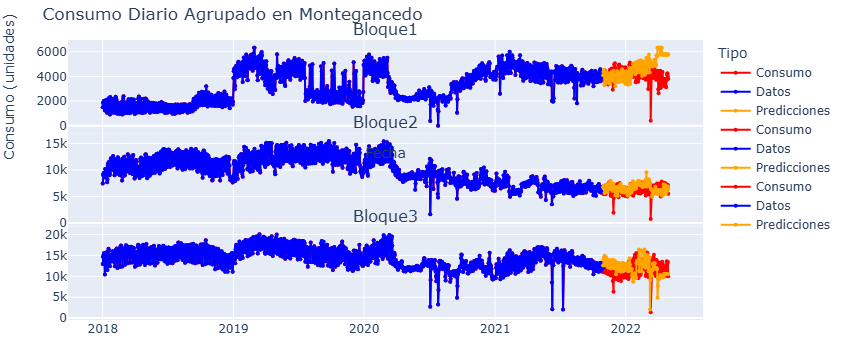

In [87]:
subplots_X_hat(Xs_sur, Xs_full_sur, dataframes_por_grupo_sur_antes_6_meses, dataframes_por_grupo_sur, X_hat_series_sur_simple)

In [88]:
mae2=calcular_MAE(Xs_full_sur, X_hat_series_sur_simple)

El error absoluto medio en la predicción del bloque: 0 es de: 892.0817174583333
El error absoluto medio en la predicción del bloque: 1 es de: 798.4051061666667
El error absoluto medio en la predicción del bloque: 2 es de: 1638.5458835833335


In [89]:
media_diccionario(mae1,mae2,"Simple")

Media de maes: 1133.0988908809525


### Exponential Smoothing

In [91]:
W = 20
alpha = 0.8


def X_hat(X, t, W, alpha):
    s = X[t-W]
    for h in range(W):
        s = alpha*X[t-W+h] + (1-alpha)*s
    return s


X_hat_series_montegancedo_exponential = [
    np.array([X_hat(X, t, W, alpha) for t in T_missing if t - W >= 0])
    for X in Xs_full_montegancedo
]

X_hat_series_sur_exponential = [
    np.array([X_hat(X, t, W, alpha) for t in T_missing if t - W >= 0])
    for X in Xs_full_sur
]

In [92]:
#subplots_X_hat_naive(Xs_montegancedo, Xs_full_montegancedo, dataframes_por_grupo_montegancedo_antes_6_meses, dataframes_por_grupo_montegancedo, X_hat_series_montegancedo_exponential)

In [93]:
mae1 = calcular_MAE(Xs_full_montegancedo, X_hat_series_montegancedo_exponential)

El error absoluto medio en la predicción del bloque: 0 es de: 842.2933366629629
El error absoluto medio en la predicción del bloque: 1 es de: 620.4032542603447
El error absoluto medio en la predicción del bloque: 2 es de: 722.889710245969
El error absoluto medio en la predicción del bloque: 3 es de: 377.5352769321003


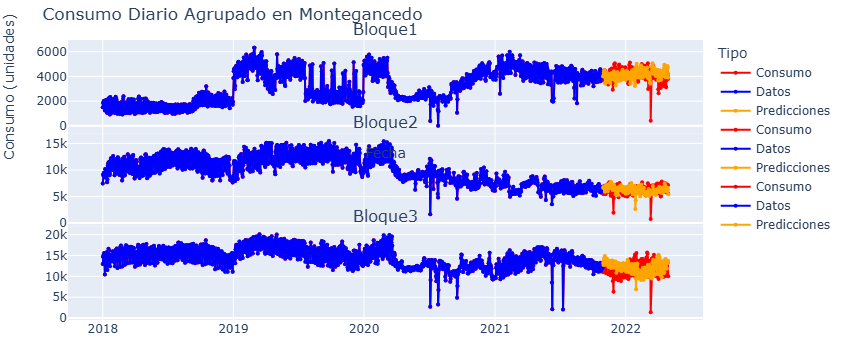

In [94]:
subplots_X_hat_naive(Xs_sur, Xs_full_sur, dataframes_por_grupo_sur_antes_6_meses, dataframes_por_grupo_sur, X_hat_series_sur_exponential)

In [95]:
mae2=calcular_MAE(Xs_full_sur, X_hat_series_sur_exponential)

El error absoluto medio en la predicción del bloque: 0 es de: 359.35857861599897
El error absoluto medio en la predicción del bloque: 1 es de: 635.8867411793769
El error absoluto medio en la predicción del bloque: 2 es de: 1145.0647146382694


In [96]:
media_diccionario(mae1,mae2,"Exponential")

Media de maes: 671.9188017907173


### AR

In [98]:
def generate_next_value_AR(X, phis, sigma, t):
    next_value = sum([phis[i-1] * X[t-i] for i in range(1, len(phis)+1)]) + np.random.normal(loc=0, scale=sigma)
    return next_value


def generate_AR_predictions(Xs, phis, sigma, T_missing):
    X_hat_series_AR = []

    for X in Xs:
        X_extended = X.copy()
        for t in T_missing:
            # Usar el índice relativo a la longitud actual
            if t == len(X_extended):  
                next_value = generate_next_value_AR(X_extended, phis, sigma, t)
                X_extended = np.hstack((X_extended, next_value))
        
        X_hat_series_AR.append(X_extended)

    return X_hat_series_AR
    
sigma = 6
phis = [0.5,0.3,0.2]
X_hat_series_montegancedo_AR = generate_AR_predictions(Xs_montegancedo, phis, sigma, T_missing)
X_hat_series_sur_AR = generate_AR_predictions(Xs_sur, phis, sigma, T_missing)

generate_AR_predictions(Xs_full_sur,phis,sigma,T_missing)

[array([1512.60734, 1858.38717, 1870.58753, ..., 4266.89561, 4029.30311,
        3808.28433]),
 array([7471.24141, 9040.92259, 9255.1897 , ..., 7140.8464 , 7171.34568,
        5547.29978]),
 array([12936.12533, 14776.35145, 14573.93484, ..., 13253.96702,
        13423.22087, 10007.47663])]

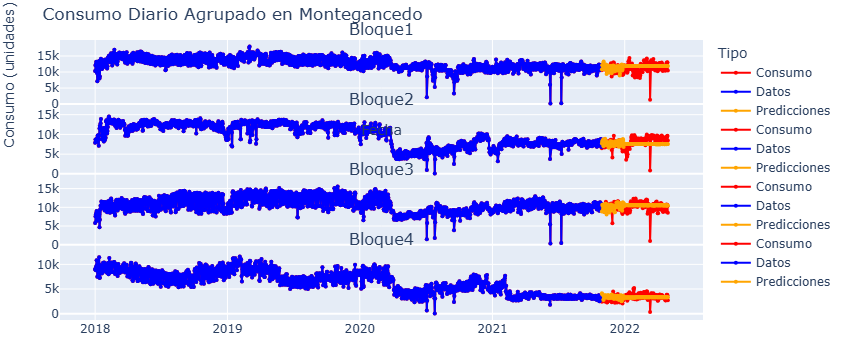

In [99]:
subplots_X_hat(Xs_montegancedo, Xs_full_montegancedo, dataframes_por_grupo_montegancedo_antes_6_meses, dataframes_por_grupo_montegancedo, X_hat_series_montegancedo_AR)

In [100]:
mae1 = calcular_MAE(Xs_full_montegancedo, X_hat_series_montegancedo_AR)

El error absoluto medio en la predicción del bloque: 0 es de: 857.9352292309163
El error absoluto medio en la predicción del bloque: 1 es de: 843.346815412869
El error absoluto medio en la predicción del bloque: 2 es de: 650.8193004001881
El error absoluto medio en la predicción del bloque: 3 es de: 352.2185429385058


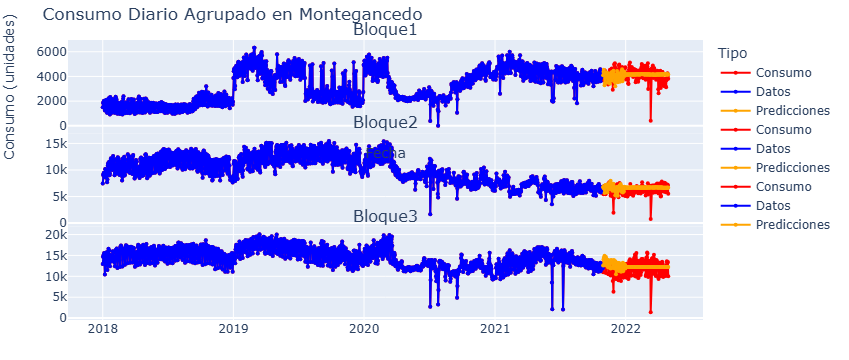

In [101]:
subplots_X_hat(Xs_sur, Xs_full_sur, dataframes_por_grupo_sur_antes_6_meses, dataframes_por_grupo_sur, X_hat_series_sur_AR)

In [102]:
mae2 = calcular_MAE(Xs_full_sur, X_hat_series_sur_AR)

El error absoluto medio en la predicción del bloque: 0 es de: 305.9780430784516
El error absoluto medio en la predicción del bloque: 1 es de: 543.646471463238
El error absoluto medio en la predicción del bloque: 2 es de: 1086.172583268286


In [103]:
media_diccionario(mae1,mae2,"AR")

Media de maes: 662.8738551132079


### MA

In [105]:
def generate_next_value_MA(thetas, sigma, epsilons):
    new_epsilon = np.random.normal(loc=0, scale=sigma)
    epsilons.pop(0)
    epsilons.append(new_epsilon)
    return sum([thetas[i] * epsilons[i] for i in range(len(thetas))])

def generate_MA_predictions(Xs, thetas, sigma, T_missing):
    X_hat_series_MA = []
    
    for X in Xs:
        X_extended = X.copy()
        epsilons = [np.random.normal(loc=0, scale=sigma) for _ in range(len(thetas))]
        
        for t in T_missing:
            # Solo generar valor si t coincide con la longitud actual de la serie extendida
            if t == len(X_extended):
                next_value = generate_next_value_MA(thetas, sigma, epsilons)
                X_extended = np.hstack((X_extended, next_value))
        
        X_hat_series_MA.append(X_extended)
    
    return X_hat_series_MA

# Parámetros
sigma = 6
thetas = [0.5, -0.3, 0.2]

# Generación de predicciones
X_hat_series_montegancedo_MA = generate_MA_predictions(Xs_montegancedo, thetas, sigma, T_missing)
X_hat_series_sur_MA = generate_MA_predictions(Xs_sur, thetas, sigma, T_missing)

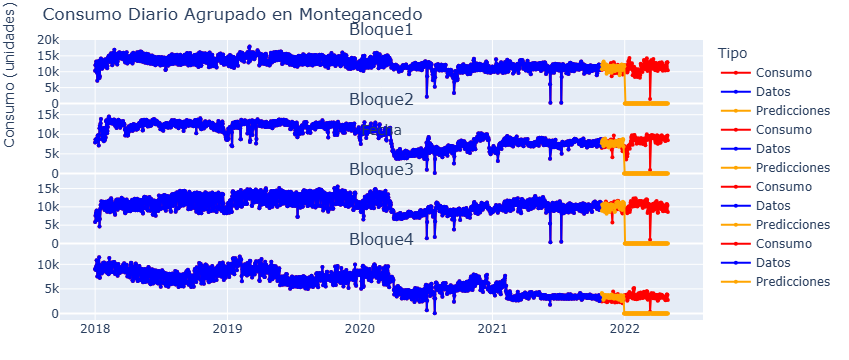

In [106]:
subplots_X_hat(Xs_montegancedo, Xs_full_montegancedo, dataframes_por_grupo_montegancedo_antes_6_meses, dataframes_por_grupo_montegancedo, X_hat_series_montegancedo_MA)

In [107]:
mae1 = calcular_MAE(Xs_full_montegancedo, X_hat_series_montegancedo_MA)

El error absoluto medio en la predicción del bloque: 0 es de: 8417.531331395776
El error absoluto medio en la predicción del bloque: 1 es de: 6082.007854438784
El error absoluto medio en la predicción del bloque: 2 es de: 7601.918786185018
El error absoluto medio en la predicción del bloque: 3 es de: 2548.606155463409


In [108]:
#subplots_X_hat(Xs_sur, Xs_full_sur, dataframes_por_grupo_sur_antes_6_meses, dataframes_por_grupo_sur, X_hat_series_sur_MA)

In [109]:
mae2 = calcular_MAE(Xs_full_sur, X_hat_series_sur_MA)

El error absoluto medio en la predicción del bloque: 0 es de: 3134.8836587335627
El error absoluto medio en la predicción del bloque: 1 es de: 4674.50204807717
El error absoluto medio en la predicción del bloque: 2 es de: 8971.555673262272


In [110]:
media_diccionario(mae1,mae2,"MA")

Media de maes: 5918.715072507999


### ARMA

In [112]:
def generate_next_value_ARMA(X, phis, thetas, mu, sigma, epsilons):
    new_epsilon = np.random.normal(loc=0, scale=sigma)
    epsilons.pop(0)
    epsilons.append(new_epsilon)
    
    AR = sum([phis[i] * X[-i-1] for i in range(len(phis))])
    MA = sum([thetas[i] * epsilons[i] for i in range(len(thetas))])
    
    return mu + AR + MA

def generate_ARMA_predictions(Xs, phis, thetas, mu, sigma, T_missing):
    X_hat_series_ARMA = []
    
    for X in Xs:
        X_extended = X.copy()
        epsilons = [np.random.normal(loc=0, scale=sigma) for _ in range(len(thetas))]
        
        for t in T_missing:
            if t == len(X_extended):  # Solo extender si t coincide con la longitud actual
                next_value = generate_next_value_ARMA(X_extended, phis, thetas, mu, sigma, epsilons)
                X_extended = np.hstack((X_extended, next_value))
        
        X_hat_series_ARMA.append(X_extended)
    
    return X_hat_series_ARMA


# Parámetros
phis = [0.5, 0.3, 0.2]
thetas = [0.5, -0.3, 0.2, -0.1]
sigma = 6
mu = 2

# Generación de predicciones
X_hat_series_montegancedo_ARMA = generate_ARMA_predictions(Xs_montegancedo, phis, thetas, mu, sigma, T_missing)
X_hat_series_sur_ARMA = generate_ARMA_predictions(Xs_sur, phis, thetas, mu, sigma, T_missing)



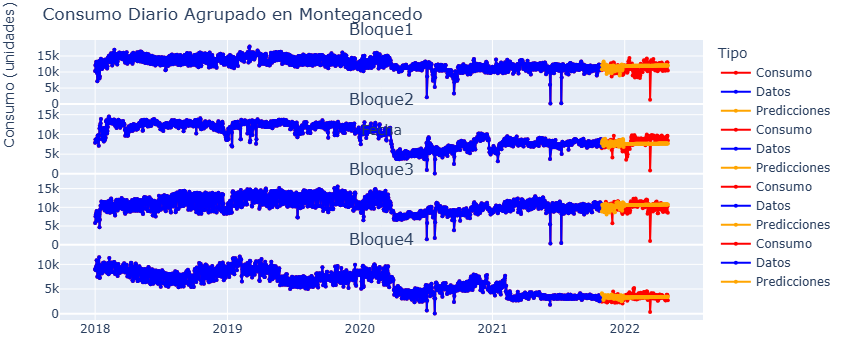

In [113]:
subplots_X_hat(Xs_montegancedo, Xs_full_montegancedo, dataframes_por_grupo_montegancedo_antes_6_meses, dataframes_por_grupo_montegancedo, X_hat_series_montegancedo_ARMA)

In [114]:
mae1 = calcular_MAE(Xs_full_montegancedo, X_hat_series_montegancedo_ARMA)

El error absoluto medio en la predicción del bloque: 0 es de: 867.5392812769959
El error absoluto medio en la predicción del bloque: 1 es de: 800.354642668666
El error absoluto medio en la predicción del bloque: 2 es de: 655.7191428557566
El error absoluto medio en la predicción del bloque: 3 es de: 337.83746645668884


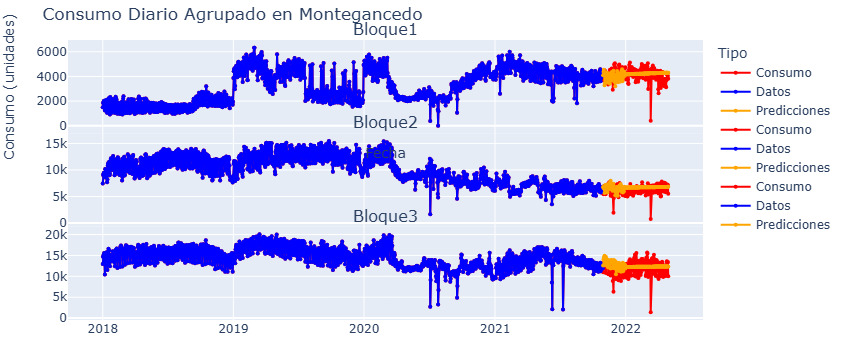

In [115]:
subplots_X_hat(Xs_sur, Xs_full_sur, dataframes_por_grupo_sur_antes_6_meses, dataframes_por_grupo_sur, X_hat_series_sur_ARMA)

In [116]:
mae2 = calcular_MAE(Xs_full_sur, X_hat_series_sur_ARMA)

El error absoluto medio en la predicción del bloque: 0 es de: 302.36996850582256
El error absoluto medio en la predicción del bloque: 1 es de: 561.4018741175862
El error absoluto medio en la predicción del bloque: 2 es de: 1076.008309653162


In [117]:
media_diccionario(mae1,mae2,"ARMA")

Media de maes: 657.3186693620968


### Análisis de parámetros ARIMA

Haremos el análisis para un solo bloque, y aunque no sea del todo cierto, diremos que el resultado es general para todos los bloques. Así podremos explicar los resultados de pmdarima

In [120]:
bloque2_sur = Xs_full_sur[1]

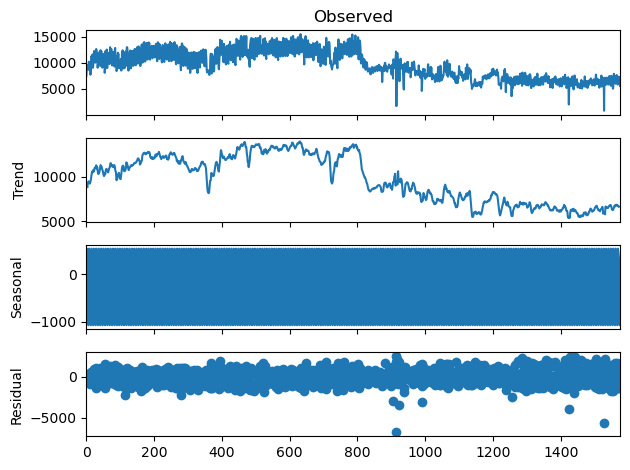

In [121]:
from statsmodels.tsa.seasonal import seasonal_decompose

result = seasonal_decompose(bloque2_sur, model='additive', period = 7)
result.plot()
plt.show()

La serie muestra fluctuaciones significativas en el tiempo, dejando ver tendencias generales y patrones estacionales.
El gráfico de trend nos deja ver una tendencia que podríamos modelar, aún tras la caída del covid. 
La componente estacional nos deja ver un patrón repetitivo para el periodo impuesto; esto junto con una amplitud constante; nos deja ver una estacionalidad fuerte, luego tal vez nos beneficiemos de algun modelo que use la seasonality (SARIMAX).
El residuo presenta ruido cuya varianza aumenta tras la segunda mitad (post-covid), lo que nos podría decir que los datos futuros son más difíciles de predecir

Como los datos no son completamente estacionarios, procederemos a diferenciarlos y estudiar como los afecta, hasta llegar a una muestra estacionaria

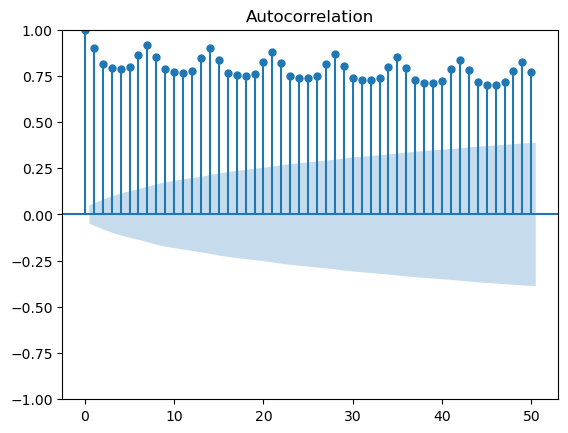

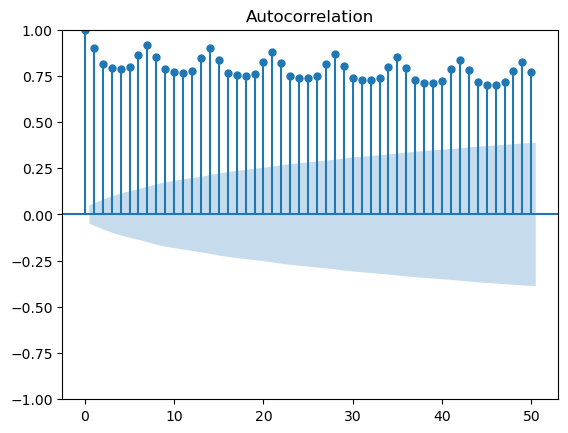

In [124]:
from statsmodels.graphics.tsaplots import plot_acf
bloque2_sur = pd.Series(bloque2_sur)
plot_acf(bloque2_sur, lags=50)


In [125]:
DX = bloque2_sur - bloque2_sur.shift(1)

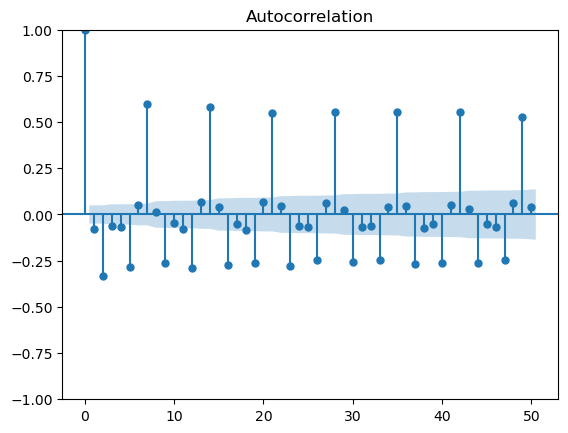

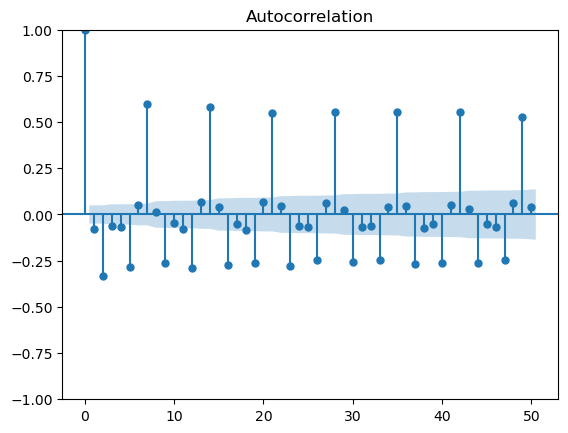

In [126]:
plot_acf(DX[1:], lags=50)

Podemos ver que con una sola diferenciación los datos ya son estacionarios con un periodo de 7, luego ya conocemos que d=1 y M=7.

### ARIMA

In [129]:
# Operator D
def differentiate(X):
    return X - X.shift(1)

# Inverse of D
def integrate(X, Y):
    return Y + X.shift(1)

def generate_next_value_ARIMA(X, phis, thetas, d, mu, sigma, epsilons, t):
    DX = [X]
    
    # Differentiate the series
    for i in range(d):
        DX.append(differentiate(DX[-1]))
    
    # Predict the differentiated series using a ARMA model
    new_epsilon = np.random.normal(loc = 0, scale = sigma)
    epsilons.pop(0)
    epsilons.append(new_epsilon)
    AR = sum([phis[i-1]*DX[-1].iloc[t-i] for i in range(1,len(phis)+1)]) + np.random.normal(loc = 0, scale = sigma)
    MA = sum([thetas[i]*epsilons[i] for i in range(len(phis))])
    Y = DX[-1] + [mu + AR + MA]
    
    # Integrate to recover the non-differentiated series
    for i in range(d-1,-1,-1):
        Y = integrate(DX[i],Y)
    
    return Y.iloc[-1]

phis = [0.5,0.3,0.2]
thetas = [0.5,-0.3,0.2,-0.1]
epsilons = [np.random.normal(loc = 0, scale = sigma) for i in range(len(thetas))]
sigma = 6
mu = 2
d = 2

X_hat_series_montegancedo_ARIMA = []
for i,X in enumerate(Xs_montegancedo):
    X_current = X
    for t in T_missing:
        pred = generate_next_value_ARIMA(pd.Series(Xs_full_montegancedo[i]), phis, thetas, d, mu, sigma, epsilons, t)
        X_current = np.hstack((X_current, pred))
    X_hat_series_montegancedo_ARIMA.append(X_current)

X_hat_series_sur_ARIMA = []
for i, X in enumerate(Xs_sur):
    X_current = X
    for t in T_missing:
        pred = generate_next_value_ARIMA(pd.Series(Xs_full_sur[i]), phis, thetas, d, mu, sigma, epsilons, t)
        X_current = np.hstack((X_current, pred))
    X_hat_series_sur_ARIMA.append(X_current)

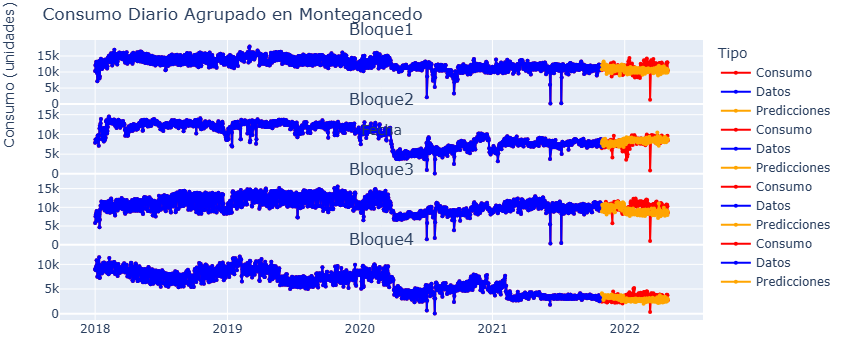

In [130]:
subplots_X_hat(Xs_montegancedo, Xs_full_montegancedo, dataframes_por_grupo_montegancedo_antes_6_meses, dataframes_por_grupo_montegancedo, X_hat_series_montegancedo_ARIMA)

In [131]:
mae1 = calcular_MAE(Xs_full_montegancedo, X_hat_series_montegancedo_ARIMA)

El error absoluto medio en la predicción del bloque: 0 es de: 1006.8086556004571
El error absoluto medio en la predicción del bloque: 1 es de: 795.3785971844269
El error absoluto medio en la predicción del bloque: 2 es de: 1338.1474234973878
El error absoluto medio en la predicción del bloque: 3 es de: 620.561563905767


In [132]:
# subplots_X_hat(Xs_sur, Xs_full_sur, dataframes_por_grupo_sur_antes_6_meses, dataframes_por_grupo_sur, X_hat_series_sur_ARIMA)

In [133]:
mae2 = calcular_MAE(Xs_full_sur, X_hat_series_sur_ARIMA)

El error absoluto medio en la predicción del bloque: 0 es de: 476.58098627188144
El error absoluto medio en la predicción del bloque: 1 es de: 740.6972117502906
El error absoluto medio en la predicción del bloque: 2 es de: 1700.234554556766


In [134]:
media_diccionario(mae1,mae2,"ARIMA")

Media de maes: 954.0584275381397


Ahora haremos una predicción empleando el método de autoarima

In [136]:
from pmdarima import auto_arima
unis = [Xs_montegancedo, Xs_sur]
forecast_results = []

for i, uni in enumerate(unis):
    forecasting = []
    for j, df in enumerate(uni):
        # Ajustar el modelo
        model = auto_arima(df, seasonal=False, stepwise=True)
        print(f"Modelo ajustado para uni[{i}] bloque [{j}]: {model}")
        
        # Generar pronóstico
        forecast = model.predict(n_periods=T_missing[-1] - T_missing[0] + 1)
        
        # Guardar el pronóstico
        forecasting.append(forecast)
    forecast_results.append(forecasting)


Modelo ajustado para uni[0] bloque [0]:  ARIMA(4,1,5)(0,0,0)[0]          
Modelo ajustado para uni[0] bloque [1]:  ARIMA(2,1,1)(0,0,0)[0]          
Modelo ajustado para uni[0] bloque [2]:  ARIMA(5,1,4)(0,0,0)[0]          
Modelo ajustado para uni[0] bloque [3]:  ARIMA(5,1,4)(0,0,0)[0]          
Modelo ajustado para uni[1] bloque [0]:  ARIMA(5,1,2)(0,0,0)[0]          
Modelo ajustado para uni[1] bloque [1]:  ARIMA(2,1,3)(0,0,0)[0]          
Modelo ajustado para uni[1] bloque [2]:  ARIMA(2,1,3)(0,0,0)[0] intercept


Como ya hemos predicho en nuestro análisis previo, todos los modelos se han ajustado para diferenciar una vez. Luego para cada uno de los bloques, la importancia de AR y MA varía, normalmente estando en 5,4 o 2. Veamos cuan "mejores" son estos modelos en cuanto a los que tenemos nosotros

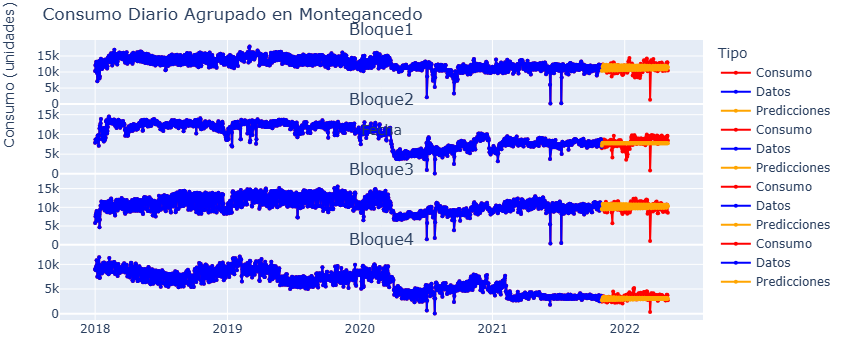

In [138]:
subplots_X_hat_naive(Xs_montegancedo, Xs_full_montegancedo, dataframes_por_grupo_montegancedo_antes_6_meses, dataframes_por_grupo_montegancedo, forecast_results[0])

In [139]:
mae1 = calcular_MAE(Xs_full_montegancedo, forecast_results[0])

El error absoluto medio en la predicción del bloque: 0 es de: 1079.609962449596
El error absoluto medio en la predicción del bloque: 1 es de: 899.5060798021151
El error absoluto medio en la predicción del bloque: 2 es de: 860.6411070285465
El error absoluto medio en la predicción del bloque: 3 es de: 523.8479920343094


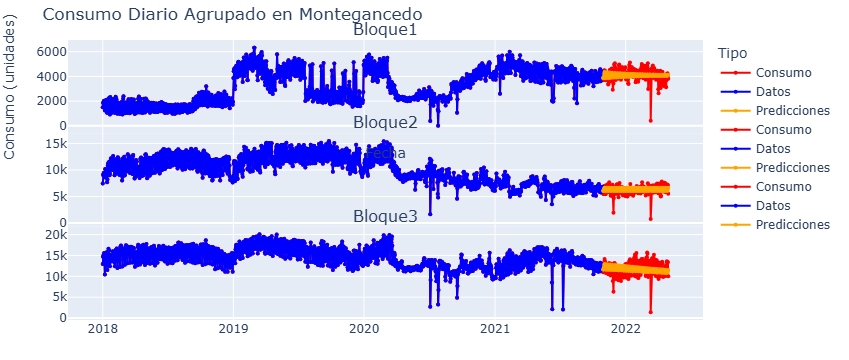

In [140]:
subplots_X_hat_naive(Xs_sur, Xs_full_sur, dataframes_por_grupo_sur_antes_6_meses, dataframes_por_grupo_sur, forecast_results[1])

In [141]:
mae2 = calcular_MAE(Xs_full_sur, forecast_results[1])

El error absoluto medio en la predicción del bloque: 0 es de: 417.4352690738785
El error absoluto medio en la predicción del bloque: 1 es de: 669.6897983637485
El error absoluto medio en la predicción del bloque: 2 es de: 1557.812047542216


In [142]:
media_diccionario(mae1,mae2,"AutoArima")

Media de maes: 858.3631794706299


### SARIMAX

In [144]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

def get_sarimax(X_series):
    X_devolver = []
    for i,X in enumerate(X_series):
        X_copy = X.copy()
        model = SARIMAX(
            X_copy,
            order=(1, 1, 1),  
            seasonal_order=(1, 1, 1, 7),
            enforce_stationarity=False,
            enforce_invertibility=False
                        )

        result = model.fit()

        forecast = result.get_forecast(steps=X.shape[0]).predicted_mean

        X_devolver.append(np.hstack((X_series[i], forecast)))
    return X_devolver

X_hat_series_montegancedo_sarimax = get_sarimax(Xs_montegancedo)
X_hat_series_sur_sarimax = get_sarimax(Xs_sur)

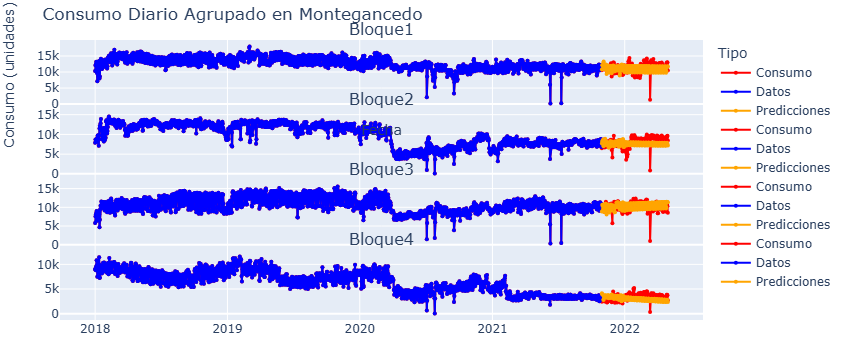

In [145]:
subplots_X_hat(Xs_montegancedo, Xs_full_montegancedo, dataframes_por_grupo_montegancedo_antes_6_meses, dataframes_por_grupo_montegancedo, X_hat_series_montegancedo_sarimax)

In [146]:
mae1 = calcular_MAE(Xs_full_montegancedo, X_hat_series_montegancedo_sarimax)

El error absoluto medio en la predicción del bloque: 0 es de: 893.1016183033157
El error absoluto medio en la predicción del bloque: 1 es de: 882.2234659688995
El error absoluto medio en la predicción del bloque: 2 es de: 744.3741746006766
El error absoluto medio en la predicción del bloque: 3 es de: 584.6991609595995


In [147]:
# subplots_X_hat(Xs_sur, Xs_full_sur, dataframes_por_grupo_sur_antes_6_meses, dataframes_por_grupo_sur, X_hat_series_sur_sarimax)

In [148]:
mae2 = calcular_MAE(Xs_full_sur, X_hat_series_sur_sarimax)

El error absoluto medio en la predicción del bloque: 0 es de: 378.16051182049813
El error absoluto medio en la predicción del bloque: 1 es de: 580.2091451727131
El error absoluto medio en la predicción del bloque: 2 es de: 1298.930501774331


In [149]:
media_diccionario(mae1,mae2,"SARIMAX")

Media de maes: 765.9569398000048


Obviamente usando un modelo general y sin tener en cuenta el análisis anterior, no podemos  esperar las mejores predicciones habidas, por lo cual, vamos a autoajustar teniendo algo más en cuenta lo ya dicho.

In [151]:
unis = [Xs_montegancedo, Xs_sur]
forecast_results = []

for i, uni in enumerate(unis):
    forecasting = []
    for j, df in enumerate(uni):
        # Ajustar el modelo
        model = auto_arima(df, seasonal=True, m=7, stepwise=True, error_action="ignore")
        print(f"Modelo ajustado para uni[{i}] bloque [{j}]: {model}")
        
        # Generar pronóstico
        forecast = model.predict(n_periods=T_missing[-1] - T_missing[0] + 1)
        
        # Guardar el pronóstico
        forecasting.append(forecast)
    forecast_results.append(forecasting)



Modelo ajustado para uni[0] bloque [0]:  ARIMA(2,1,0)(1,0,1)[7] intercept
Modelo ajustado para uni[0] bloque [1]:  ARIMA(0,1,3)(1,0,2)[7]          
Modelo ajustado para uni[0] bloque [2]:  ARIMA(0,1,2)(2,0,1)[7]          
Modelo ajustado para uni[0] bloque [3]:  ARIMA(1,1,2)(1,0,1)[7]          
Modelo ajustado para uni[1] bloque [0]:  ARIMA(2,1,1)(2,0,1)[7] intercept
Modelo ajustado para uni[1] bloque [1]:  ARIMA(1,1,1)(1,0,1)[7] intercept
Modelo ajustado para uni[1] bloque [2]:  ARIMA(0,1,2)(1,0,1)[7] intercept


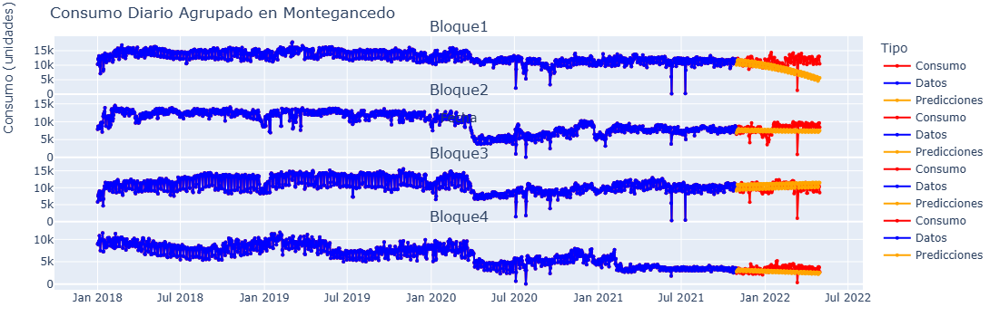

In [152]:
subplots_X_hat_naive(Xs_montegancedo, Xs_full_montegancedo, dataframes_por_grupo_montegancedo_antes_6_meses, dataframes_por_grupo_montegancedo, forecast_results[0])

In [153]:
mae1 = calcular_MAE(Xs_full_montegancedo, X_hat_series_montegancedo_sarimax)

El error absoluto medio en la predicción del bloque: 0 es de: 893.1016183033157
El error absoluto medio en la predicción del bloque: 1 es de: 882.2234659688995
El error absoluto medio en la predicción del bloque: 2 es de: 744.3741746006766
El error absoluto medio en la predicción del bloque: 3 es de: 584.6991609595995


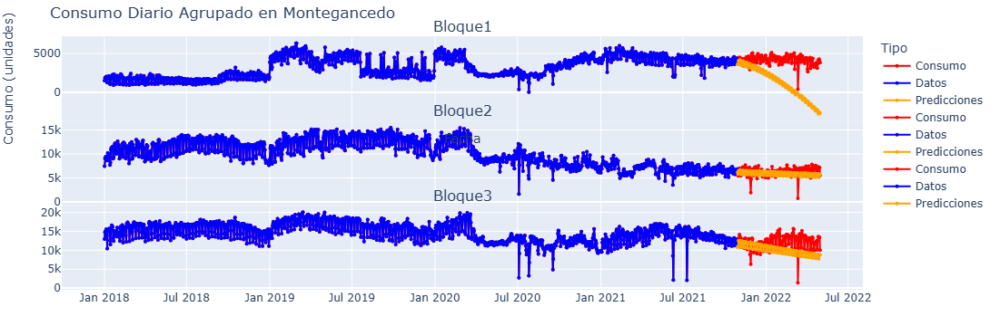

In [154]:
subplots_X_hat_naive(Xs_sur, Xs_full_sur, dataframes_por_grupo_sur_antes_6_meses, dataframes_por_grupo_sur, forecast_results[1])

In [155]:
mae2 = calcular_MAE(Xs_full_sur, forecast_results[1])

El error absoluto medio en la predicción del bloque: 0 es de: 4392.083423609484
El error absoluto medio en la predicción del bloque: 1 es de: 791.7028423487993
El error absoluto medio en la predicción del bloque: 2 es de: 2873.823825764639


In [156]:
media_diccionario(mae1,mae2,"AutoSARIMAX")

Media de maes: 1594.5726445079163


### Comparación resultados

In [158]:
mae_df = pd.DataFrame(list(mae_dict.items()), columns=["algoritmo", "media"])

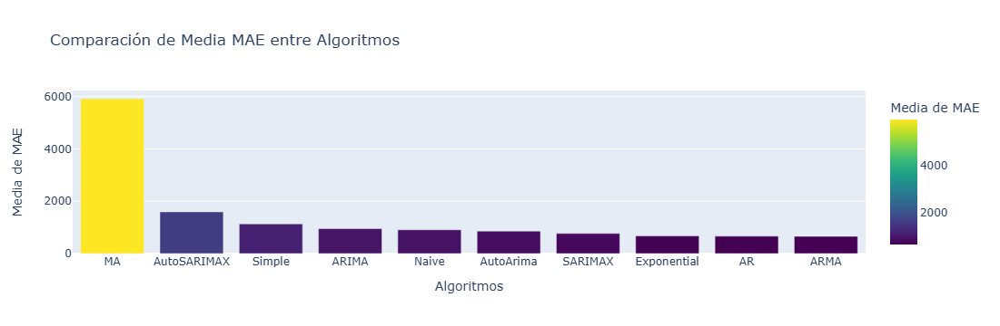

In [159]:
# Crear el gráfico de barras
import plotly.express as px
# Ordenar el DataFrame de mayor a menor
mae_df_sorted = mae_df.sort_values(by='media', ascending=False)

# Crear el gráfico
fig = px.bar(mae_df_sorted, x='algoritmo', y='media', 
             title='Comparación de Media MAE entre Algoritmos',
             labels={'algoritmo': 'Algoritmos', 'media': 'Media de MAE'},
             color='media', 
             color_continuous_scale='Viridis',
             category_orders={"algoritmo": mae_df_sorted['algoritmo'].tolist()})

# Mostrar el gráfico
fig.show()